# <p align="center">Social Network Analysis (SAN) Project</p>

### <p align="center"></p>
### <p align="center">Antonia Bonfa, Weiping Zhang (FS 2024)</p>

### <p align="center">Data Science, FHNW</p>


In [123]:
import os
import pandas as pd
import numpy as np
import random
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx
import itertools
from itertools import combinations
from collections import Counter
from scipy.stats import pearsonr
from networkx.algorithms import bipartite, community
import warnings
warnings.filterwarnings('ignore')


# 1 Exploratory data analysis
## 1.1 Load data and check data size, missing values


Data source: https://www.kaggle.com/datasets/csanhueza/the-marvel-universe-social-network
The dataset contains heroes and comics, and the relationship between them. The dataset is divided into three files:

nodes.csv: Contains two columns (node, type), indicating the name and the type (comic, hero) of the nodes.
edges.csv: Contains two columns (hero, comic), indicating in which comics the heroes appear.
hero-edge.csv: Contains the network of heroes (columns hero1,hero2) which appear together in the comics. This file was originally taken from http://syntagmatic.github.io/exposedata/marvel/

In [124]:
nodes = pd.read_csv('data/nodes.csv')
edges = pd.read_csv('data/edges.csv')
network = pd.read_csv('data/hero-network.csv')
print(f"Node file size {nodes.shape}, with {nodes.isna().sum().sum()} NaN\n")
print(nodes.describe())

print(f"\nEdges file size {edges.shape}, with {edges.isna().sum().sum()} NaN\n")
print(edges.describe())

print(f"\nNetwork file size {network.shape}, with {network.isna().sum().sum()} NaN\n")
print(network.describe())


Node file size (19090, 2), with 0 NaN

           node   type
count     19090  19090
unique    19090      2
top     2001 10  comic
freq          1  12651

Edges file size (96104, 2), with 0 NaN

                           hero  comic
count                     96104  96104
unique                     6439  12651
top     SPIDER-MAN/PETER PARKER  COC 1
freq                       1577    111

Network file size (574467, 2), with 0 NaN

                  hero1            hero2
count            574467           574467
unique             6211             6173
top     CAPTAIN AMERICA  CAPTAIN AMERICA
freq               8149             8350


In [125]:
nodes.type.value_counts()

comic    12651
hero      6439
Name: type, dtype: int64

-   **node**: Total 19090 data points The data points are either comics or heros. There are no missing values.

-   **edges**: Total 96104 data points: 12651 comics and 6439 heroes. Also contains no missing values.

-   **network**: Total 574467 data points, with about 6200 unique values. As this is less than the number of heroes in the edge file, there are probably some self loops.  Again no missing values. These can be used as edges between heroes for a one mode network.

 Thankfully, the datasets from kaggle have already been cleaned, as there are no missing values. However, we seem to have varying numbers of heroes in the files (6439 in the edges + nodes files vs 6211 / 6173 in the network file). We will have to clean this up if we want to potentially use information from all 3 files.



##  1.2 Check and fix consistency and other potential issues
### 1.2.1 Consistency of hero names in edges and network dataset

In [126]:
# hero1 and hero2
def compare_heroes_in_edges_network(edges, network, verbose=False):
    heroes_in_network = set(network['hero1']).union(set(network['hero2']))
    heroes_in_edges = set(edges['hero'])
    heroes_in_network_and_edges = heroes_in_network.intersection(heroes_in_edges) 
    heroes_not_in_edges = heroes_in_network.difference(heroes_in_edges)
    heroes_not_in_network = heroes_in_edges.difference(heroes_in_network)
    heroes_not_in_common = heroes_in_network.symmetric_difference(heroes_in_edges)
    print(f"Heroes in network: {len(heroes_in_network)}")
    print(f"Heroes in edges: {len(heroes_in_edges)}")
    print(f"Heroes in network and edges: {len(heroes_in_network_and_edges)}")
    print(f"Heroes in network but not in edges: {len(heroes_not_in_edges)}: {heroes_not_in_edges}")
    print(f"Heroes in edges but not in network: {len(heroes_not_in_network)}: {heroes_not_in_network}")
    if verbose:
        return heroes_not_in_common
compare_heroes_in_edges_network(edges, network)

Heroes in network: 6426
Heroes in edges: 6439
Heroes in network and edges: 6282
Heroes in network but not in edges: 144: {'DR. SPECTRUM II/DR. ', 'INVISIBLE WOMAN/SUE ', 'PAINTER/WILHELM VON ', 'SABRE', 'BLACK KNIGHT V/DANE ', 'MORBIUS/DR. MICHAEL ', 'POWERSURGE/ILLARION ', 'GARDENER/ORD ZYONYZ ', 'PURPLE MAN/ZEBEDIAH ', 'RICHARDS, FRANKLINK ', 'HOBGOBLIN III/LEFTY ', 'COY, GENERAL NGUYEN ', 'IRON MAN/TONY STARK ', 'BLACK KNIGHT II/SIR ', 'RAPTOR II/PROFESSOR ', 'JUGGERNAUT | MUTANT ', 'JARVIS, EDWIN ', 'PILEDRIVER II/BRIAN ', 'MORNING STAR/ZVEZDA ', 'PROFESSOR X/CHARLES ', 'JAMESON, COL. JOHN ', 'X-MAN/NATHAN GREY ', 'AGAMEMNON II/ANDREI ', 'AURORA/JEANNE-MARIE ', 'SNOWBIRD/NARYA/ANNE ', 'GYRICH, HENRY PETER ', 'OUTRIDER/OCLIN UWIR ', 'CORRIGAN, ARCHIBALD ', 'VISION DOPPELGANGER ', 'GAMBIT DOPPELGANGER ', 'MR. SINISTER/NATHAN ', 'FURY, COL. NICHOLAS ', 'WARRIOR WOMAN/JULIA ', 'WILD CHILD | MUTANT ', 'ICEMAN/ROBERT BOBBY ', 'MISSING LINK II/RAY ', 'SHOCKWAVE/LANCASTER ', 'GAMBIT/REMY L

As we can see, there appear to be different ways how the names are present in the files, as well as different numbers of heroes.
It seems the names are capped at 20 characters in one file. We will fix this by modifying all hero columns to the same length so they are unified.

In [127]:
edges['hero'] = edges['hero'].apply(lambda x: x[:20].strip())
network['hero1'] = network['hero1'].apply(lambda x: x[:20].strip())
network['hero2'] = network['hero2'].apply(lambda x: x[:20].strip())
heroes_not_in_common = compare_heroes_in_edges_network(edges, network, verbose=True)

Heroes in network: 6421
Heroes in edges: 6439
Heroes in network and edges: 6419
Heroes in network but not in edges: 2: {'SABRE', 'BLADE'}
Heroes in edges but not in network: 20: {'JOHNSON, LYNDON BAIN', 'RED WOLF II', 'GERVASE, LADY ALYSSA', 'CALLAHAN, DANNY', 'BLADE/', 'FENRIS', 'BLARE/', 'SHARKSKIN', 'LUNATIK II', 'ZANTOR', 'DEATHCHARGE', 'BERSERKER II', 'MARVEL BOY II/MARTIN', 'CLUMSY FOULUP', 'RUNE', 'RANDAK', 'SABRE/', 'GIURESCU, RADU', 'SEA LEOPARD', 'KULL'}


-   Now we have unified most of the hero names in both network and edges files.
-   We have identified 22 hero names that are absent from either the edges or the network file. 
-   Based on our understanding of Marvel heroes, these characters are not among the most recognized. Therefore, we will exclude them from all our datasets.

In [128]:
# Exclude the heroes not in common
edges = edges[~edges['hero'].isin(heroes_not_in_common)]
network = network[~(network['hero1'].isin(heroes_not_in_common)) & (~network['hero2'].isin(heroes_not_in_common))]
compare_heroes_in_edges_network(edges, network)

Heroes in network: 6419
Heroes in edges: 6419
Heroes in network and edges: 6419
Heroes in network but not in edges: 0: set()
Heroes in edges but not in network: 0: set()


### 1.2.2 Selfloops in networks

In [129]:
selfloops = network.loc[network.hero1 == network.hero2].count()[0]
print(f'selfloops in network: {selfloops} out of total {network.shape[0]} edges')

# drop selfloops
network = network.loc[network['hero1'] != network['hero2']].reset_index(drop = True)
selfloops_new = network.loc[network.hero1 == network.hero2].count()[0]
print(f'selfloops after fixing: {selfloops_new}')

selfloops in network: 2232 out of total 574246 edges
selfloops after fixing: 0


In the network file, out of our total 574467 edges 2232 were self loops, which we removed.


### 1.2.3 Network symmerty
We will now check if the network is symmetrical or not: if there is an entry for hero1 and hero2, is there also one for hero2 and hero1? For this we will just pick the first hero-coupling in the dataset:

In [130]:
display(network.head(1))
abner_zanda = network.loc[(network.hero1 == 'LITTLE, ABNER')&(network.hero2 == 'PRINCESS ZANDA')].hero1.count()
zander_abner = network.loc[(network.hero2 == 'LITTLE, ABNER')&(network.hero1 == 'PRINCESS ZANDA')].hero1.count()

print(f'Edges with Abner Little first and Princess Zanda second:{abner_zanda}\nEdges with Princess Zanda first and Abner Little second:{zander_abner}')

,hero1,hero2
0,"LITTLE, ABNER",PRINCESS ZANDA


Edges with Abner Little first and Princess Zanda second:5
Edges with Princess Zanda first and Abner Little second:3


It appears the dataframe is not symmetrical: the coupling of hero1 and hero2 is not the same depending on which hero is first.
To fix the problem we will sort the hero names by alphabetical order to ensure that the same pair of heroes are not repeated in the network. For example, the connections of hero A - hero B and hero B - hero A will both be converted to hero A - hero B.

In [131]:
network[['hero1', 'hero2']] = network.apply(lambda x: sorted([x['hero1'], x['hero2']]), axis=1, result_type='expand')

abner_zanda = network.loc[(network.hero1 == 'LITTLE, ABNER')&(network.hero2 == 'PRINCESS ZANDA')].hero1.count()
zander_abner = network.loc[(network.hero2 == 'LITTLE, ABNER')&(network.hero1 == 'PRINCESS ZANDA')].hero1.count()

print(f'Edges with Abner Little first and Princess Zanda second:{abner_zanda}\nEdges with Princess Zanda first and Abner Little second:{zander_abner}')

Edges with Abner Little first and Princess Zanda second:8
Edges with Princess Zanda first and Abner Little second:0


## 1.3 Generate new features

## 1.3.1 Generate hero node features: count_appearance, rank, gender
-   count_appearance: number of appearance of hero character in comic books.
-   rank: popularity of hero measured by count_appearance.
-   gender: gender of the hero (only for the top-100 heroes). As we have no easy way of doing it and our interest lies in female heroes, we will hardcode the top 100 heroes gender. We assume that everyone who is not female is male. To know which heroes are female, we gave chat-gpt the list of the top 100 heroes and asked it to identify all female heroes. We then manually cross-checked the list to make sure there was no mistake.


In [132]:
hero_nodes = edges.groupby(by = 'hero').count().reset_index().drop_duplicates().sort_values(by='comic', ascending=False).reset_index(drop=True)
hero_nodes.columns = ['hero', 'count_appearance']
hero_nodes['rank'] = range(1, len(hero_nodes) + 1)
top_100_heroes = hero_nodes['hero'][:100].tolist()

In [133]:
"""
Usage of Chat-GPT: To identify the female heroes in the top100 heroes. The values were then manually checked.
"""
female_heroes = [
    "INVISIBLE WOMAN/SUE", "SCARLET WITCH/WANDA", "WATSON-PARKER, MARY", "WASP/JANET VAN DYNE", "STORM/ORORO MUNROE S", 
    "MARVEL GIRL/JEAN GRE", "SHADOWCAT/KATHERINE", "ROGUE /", "SHE-HULK/JENNIFER WA", "BLACK WIDOW/NATASHA", "CRYSTAL [INHUMAN]", "SIF",
    "WOLFSBANE/RAHNE SINC", "PSYLOCKE/ELISABETH B", "CLEA", "JUBILEE/JUBILATION L", "BOOMER/TABITHA SMITH", "MOCKINGBIRD/DR. BARB",
    "BINARY/CAROL DANVERS", "MIRAGE II/DANIELLE M", "TIGRA/GREER NELSON", "BANNER, BETTY ROSS T",
    "LEEDS, BETTY BRANT", "MASTERS, ALICIA REIS", "POLARIS/LORNA DANE", "HUDSON, HEATHER", "PAGE, KAREN", "PARKER, MAY",
    "MACTAGGERT, MOIRA KI", "NORRISS, SISTER BARB", "CAPTAIN MARVEL II/MO"]

male_heroes = [hero for hero in top_100_heroes if hero not in female_heroes]
hero_nodes['gender'] = np.select([hero_nodes['hero'].isin(female_heroes), hero_nodes['hero'].isin(male_heroes)], ['f','m'], default = np.nan)
hero_nodes

,hero,count_appearance,rank,gender
0,SPIDER-MAN/PETER PAR,1577,1,m
1,CAPTAIN AMERICA,1334,2,m
2,IRON MAN/TONY STARK,1150,3,m
3,THING/BENJAMIN J. GR,963,4,m
4,THOR/DR. DONALD BLAK,956,5,m
...,...,...,...,...
6414,LEAP FROG/LANG,1,6415,nan
6415,SILICON/GERALD SIMMS,1,6416,nan
6416,EZEKEEL,1,6417,nan
6417,SILENCER,1,6418,nan


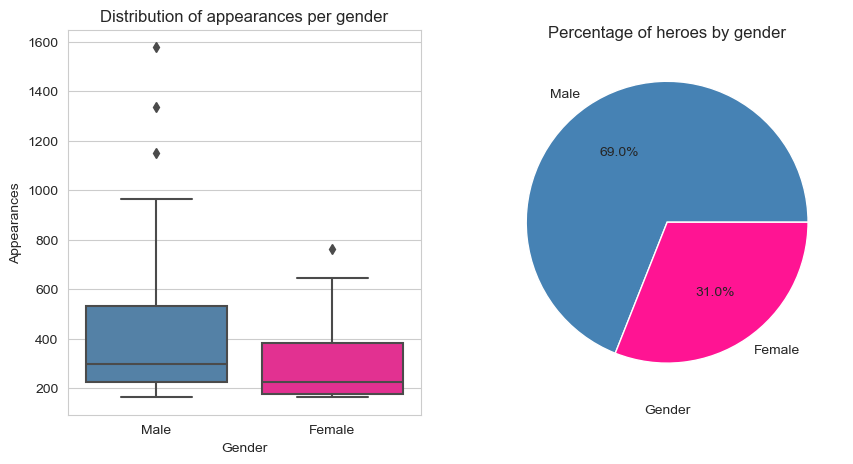

In [134]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

colors = {'f': 'deeppink', 'm': 'steelblue'}

sns.boxplot(data=hero_nodes[:100], x='gender', y='count_appearance', palette=colors, ax=ax[0]).set_title('Distribution of appearances per gender')
ax[0].set_xticklabels(['Male', 'Female'])
ax[0].set_xlabel('Gender')
ax[0].set_ylabel('Appearances')

hero_nodes[:100].gender.value_counts().plot(kind='pie', autopct='%1.1f%%', ax=ax[1], colors=['deeppink' if x == 'f' else 'steelblue' for x in hero_nodes[:100].gender.value_counts().index], labels=['Male', 'Female']).set_title('Percentage of heroes by gender')
ax[1].set_xlabel('Gender')
ax[1].set_ylabel("")
plt.show()



From our top100 heroes, 31 are female, which is quite good! Looking at how often heroes have appeared in comics for each gender, we see that men appear more frequent than women in general. This might be due to them staring in longer running series, and being more often a standalone hero instead of a group member (for example Iron Man, Spider-Man, Thor).

## 1.3.2 Generate edge features: count_co_appearance, rank_edges, gender_edges
As our datasets are very basic,we will enhance our data with some attributes for the nodes and edges.

-   count_co_appearance: number of appearance of hero character in comic books.
-   rank_edges: by count_co_appearance.
-   gender_edges: only if both heroes are top-100 most appeared
    f-f: if both are females
    m-m: if both are males
    f-m: if one male and one female

In [135]:
# count_co_appearance
network = network.groupby(['hero1', 'hero2']).size().reset_index(name='count_co_appearance').sort_values(by='count_co_appearance', ascending=False)
# rank_edges
network['rank_edges'] = range(1, len(network) + 1)
# gender_edges
conditions = [
    (network['hero1'].isin(male_heroes) & network['hero2'].isin(male_heroes)),  
    (network['hero1'].isin(female_heroes)) & (network['hero2'].isin(female_heroes)),  
    (~network['hero1'].isin(top_100_heroes)) & (~network['hero2'].isin(top_100_heroes))]

network['gender_edges'] = np.select(conditions, ['m-m', 'f-f', np.nan], default='f-m') 
# extract the network with only the top-100 heroes
network_top_100 = network.loc[network.hero1.isin(top_100_heroes)&network.hero2.isin(top_100_heroes)].reset_index(drop=True) 
network#[network['gender_edges']=='m-m']

,hero1,hero2,count_co_appearance,rank_edges,gender_edges
134205,MISS AMERICA/MADELIN,PATRIOT/JEFF MACE,1894,1,nan
103362,HUMAN TORCH/JOHNNY S,THING/BENJAMIN J. GR,744,2,m-m
102950,HUMAN TORCH/JOHNNY S,MR. FANTASTIC/REED R,713,3,m-m
137260,MR. FANTASTIC/REED R,THING/BENJAMIN J. GR,708,4,m-m
106511,INVISIBLE WOMAN/SUE,MR. FANTASTIC/REED R,701,5,f-m
...,...,...,...,...,...
71954,DRAX DOPPELGANGER,VISION,1,167027,f-m
71953,DRAX DOPPELGANGER,VINDICATOR II DOPPEL,1,167028,nan
71952,DRAX DOPPELGANGER,UATU,1,167029,nan
71951,DRAX DOPPELGANGER,THUNDERSTRIKE/ERIC K,1,167030,nan


The gender of edges are only available for the edges when both heroes are in top_100_heroes list.
As we can see, even that though the 'MISS AMERICA/MADELIN'-'PATRIOT/JEFF MACE' edges have the highest count, they do not have available gender_edges, as at least one of them is not in top_100_heroes.

## 1.4 Distribution
We will now look at the values a bit more in detail and see how they are distributed. To be able to group the comic issues, we introduce a new column called series, which will identify the series from the comic book issues.

#### 1.4.1 Nodes File

In [136]:
nodes['series'] = nodes.loc[nodes.type == 'comic'].node.str.split().str[0]

print(f'Number of different series: {nodes.series.nunique()}')

Number of different series: 670


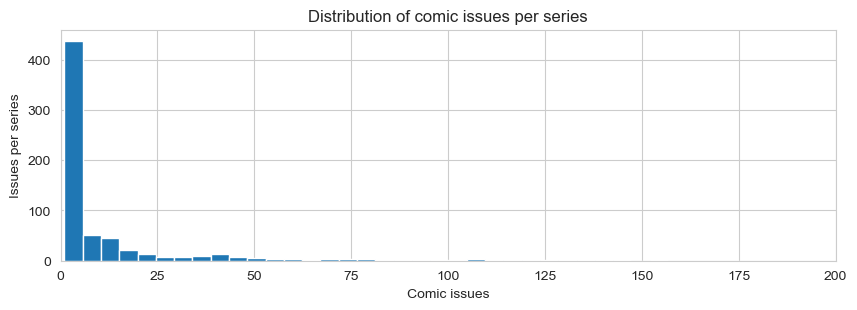

In [137]:
plt.figure(figsize=(10,3))
nodes.value_counts('series').plot(kind='hist', bins = 100,title = "Distribution of comic issues per series")
plt.xlabel('Comic issues')
plt.ylabel('Issues per series')
plt.xlim(0, 200)
plt.show()

As we can see, we have a total of 670 different series, of which most only feature a couple of issues - more than 25 issues is rather an exception. However, many of these will likely be part of the same universe or group. As we are interested in the most popular heroes, let's look at the comic series with the most issues:

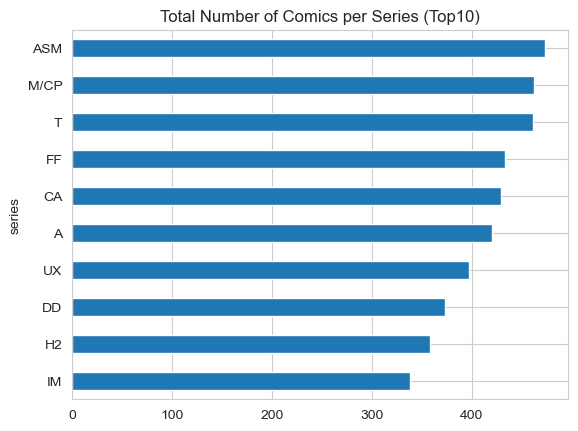

In [138]:
nodes.value_counts('series').nlargest(10).plot(kind='barh',title = "Total Number of Comics per Series (Top10)")
plt.gca().invert_yaxis()
plt.show()


The series with the most comic book issues is Amazing Spider-Man, followed by the anthology "Marvel Comics presents" which would focus on individual members of the X-Men. After that we have Thor, Fantastic Four and Captain America. Avengers are on spot 5. X-Men then appear again in the Ultimate X-Men series. Next up we have DareDevil and Iron-Man - unfortunately, we were not able to identify H2.
Given how many issues the top series have, we expect that heroes featured in these comics to be central in our network. More appearances means higher popularity (according to our filter method), and therefore probably more connections. So we can expect Spider-Man, X-Men, Thor, Captain America and the other Avengers to surely be quite central. Even though X-Men appear in our list twice, it remains to be seen how central they will be, as this is a big group of heroes - therefore, each individual hero might not be published very often.

#### 1.4.2 Edges File
In the edges file we have the columns hero and comic. It depicts which hero appears in which comic issue. Again, we will add the column series to better see which hero appears frequently in which series.


In [139]:
edges['series'] = edges.comic.str.split().str[0]
print(edges.head())

                   hero   comic series
0  24-HOUR MAN/EMMANUEL  AA2 35    AA2
1  3-D MAN/CHARLES CHAN   AVF 4    AVF
2  3-D MAN/CHARLES CHAN   AVF 5    AVF
3  3-D MAN/CHARLES CHAN   COC 1    COC
4  3-D MAN/CHARLES CHAN  H2 251     H2


Next up, we will look at the top30 heroes by edges: these heroes have appeared in the most comic issues overall. Here, we will distinguish between men and women.

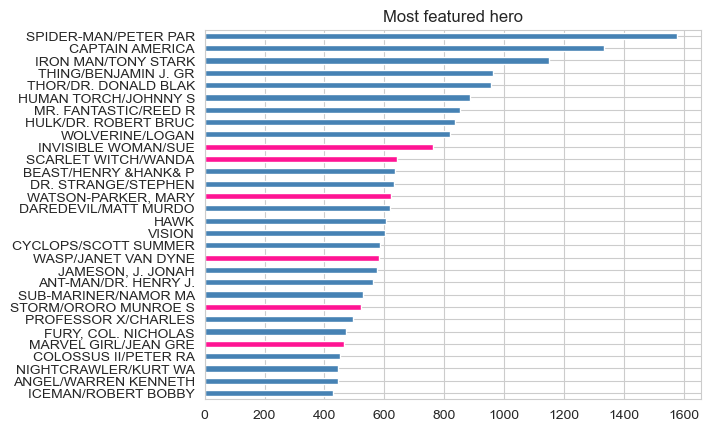

In [140]:
n = 30
most_popular_heroes = edges.hero.value_counts()

colors = ['deeppink' if hero in female_heroes else 'steelblue' for hero in most_popular_heroes.index]
most_popular_heroes.nlargest(n).plot(kind = 'barh', title = 'Most featured hero', color = colors)
plt.gca().invert_yaxis()
plt.show()

If we just look at the total number of times the hero appears in any comic, we see that Spider Man, Captain America and Iron Man are the top 3 heroes. As they appear way more frequent than just in their own series, it is likely they are featured in other comics as well. These heroes will most likely be well connected and have a high centrality index. We have 6 women in the top30, which is about 20% - this is no much worse than their share in the top100 heroes.
Not surprising, Invisible Woman (a member of the Fantastic Four) is the most featured woman - however she is less popular than her male teammates Thing, Human Torch and Mr. Fantastic. The other women as well are mostly less popular than their male counterparts. This might also be because their characters were created later than some male heroes, or that they are side-characters instead of main heroes (such as Mary Watson-Parker).
To check our assumption that the top heroes star in multiple series, we will plot the number of series a hero has been featured in:

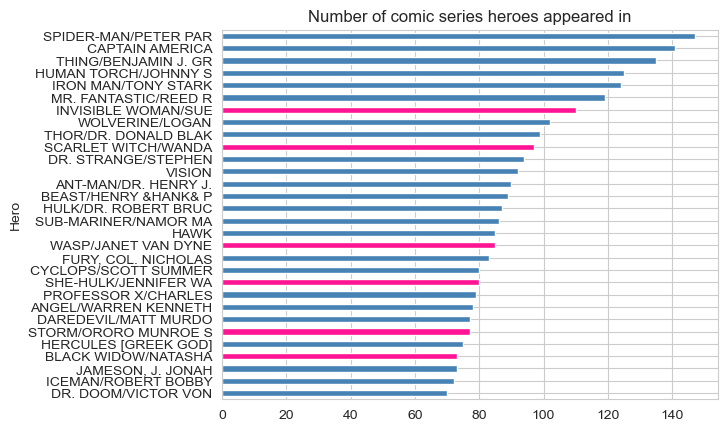

In [141]:
heroes_multiseries = edges.groupby('hero').series.nunique()
colors = ['deeppink' if hero in female_heroes else 'steelblue' for hero in heroes_multiseries.nlargest(n).index]

heroes_multiseries.nlargest(n).plot(kind = 'barh', title = 'Number of comic series heroes appeared in', color = colors)
plt.gca().invert_yaxis()
plt.ylabel('Hero')
plt.show()

As we can see, our top heroes by appearances are also the ones that appear in the most series, so our assumption is correct. Looking at how many series the heros star in vs. how many series they are (670), it seems that the most popular heroes appear in about 20% of all Marvel series! This indicates that at least some Marvel heroes are well interconnected to all different Marvel groups and heroes, so once more we have a hint that we will see these heroes in the center of our network.


### Conclusion of eda
Our data is clean, and can be used out of the box. We had some minor issues with spelling and inconsistent number of heroes that we cleaned up.
From our priliminary EDA we already have a good idea which heroes are the most popular ones, and which we can expect to be featured heavily in our network analysis. Since we have a lot of heroes and edges, we will reduce the heroes to have a more manageable dataset.

# 2 Network Reduction and Modeling


## 2.1 Reduce the data size to focus on the most popular heroes and most significant edges

-   Select top-100 most appeared heroes
-   Keep only the most significant co-appearance hero-hero connections, otherwise we will get a network where every hero is connected with every other heroes. For this step, we will test different threshold to select the most suitable network size for our project.



## 2.2 Plotting the network

In [142]:
"""
Usage of Chat-GPT: To create this function, Chat-GPT was used for certain parts:
- Setting the edge thickness based on the co-appearances was written with help of Chat-GPT, as well as labeling the top10 and bottom 10 nodes.

"""
def filter_one_mode_network(threshold, network = network_top_100, nodes = top_100_heroes,with_labels=False, save_graph=False, plot_graph = True, with_color = 'none', edge_width_factor = 1, print_information = True):
    '''
    Filter the one-mode network to only include edges with at least threshold co-appearances
    ----------
    Input:
    - threshold: int, minimum number of co-appearances for an edge to be included in the network
    - network: pd.DataFrame, one-mode network, the nodes should have the same type, e.g. heroes
    - with_labels: bool, whether to show the node labels, default is False
    - save_graph: str, name of the file to save the graph, default is False
    - with_color: 'both', 'node', 'edge', 'none'
    ----------
    Display:
    - Networkx graph object
    - Network information
    - save_graph as gexf file
    '''
    
    network_top_100_lst = [(row['hero1'], row['hero2'], {'count': row['count_co_appearance'], 'gender': row['gender_edges']}) for _, row in network.iterrows() if row['count_co_appearance'] >= threshold]
    

    # Create a networkx graph object
    G = nx.Graph(name=f"One-Mode Hero Network with threshhold {threshold}")
    G.add_nodes_from(nodes)
    G.add_edges_from(network_top_100_lst)

    stats = {'threshhold': threshold,
             'nodes': G.number_of_nodes(),
             'edges': G.number_of_edges(),
             'density': round(nx.density(G),2),
             'cluster_coeff': round(nx.average_clustering(G), 2)}

    #Print some statistics
    if print_information:
        print(f'Metrics for {G.name}\n'
              f'Number of nodes: {G.number_of_nodes()}\n'
              f'Number of edges: {G.number_of_edges()}\n'
              f'Density: {round(nx.density(G),2)}\n'
              f'Cluster Coefficient: {round(nx.average_clustering(G), 2)}')


    # Draw the graph
    if plot_graph == True:

        counts = list(nx.get_edge_attributes(G, 'count').values())
        edge_widths = [edge_width_factor*2*(count - min(counts)) / (max(counts) - min(counts)) for count in counts]

        node_colors = ['deeppink' if node in female_heroes else 'steelblue' for node in G.nodes()]
        gender_colors = {'m-m': 'steelblue', 'f-f': 'deeppink'}

        plt.figure(figsize=(15, 10))
        if threshold == 0:
            # labeling top10 & bottom 10 nodes
            top_and_bottom_nodes = sorted(G.degree, key=lambda x: x[1], reverse=True)[-10:]+ sorted(G.degree, key=lambda x: x[1], reverse=True)[:10]
            node_labels = {node: node for node, _ in top_and_bottom_nodes}
            nx.draw_networkx(G, pos=nx.kamada_kawai_layout(G),width=edge_widths, node_size = 20, node_color = node_colors, with_labels=True, labels=node_labels, font_size = 8, edge_color = 'gray')

            plt.title(f"Complete Network of Top-100 Heroes (Top 10 & Bottom 10 labeled))")    
            plt.show()
        else:
            
            if with_color == 'both':
                nx.draw_kamada_kawai(G, with_labels=with_labels, edge_color=[gender_colors.get(G.edges[edge]['gender'], 'orange') for edge in G.edges()], node_color=node_colors, node_size=20, font_size=8, width = edge_widths)
            
            elif with_color == 'node':
                nx.draw_kamada_kawai(G, with_labels=with_labels, edge_color='gray', node_size=20, font_size=8, node_color=node_colors, width = edge_widths)
            
            elif with_color == 'edge':
                nx.draw_kamada_kawai(G, with_labels=with_labels, edge_color=[gender_colors.get(G.edges[edge]['gender'], 'orange') for edge in G.edges()], node_size=20, font_size=8, width = edge_widths)

            elif with_color == 'none':
                nx.draw_kamada_kawai(G, with_labels=with_labels, edge_color='gray', node_size=20, font_size=8, width = edge_widths)
        
            plt.title(f"Network of Top-100 Heroes with at least {threshold} Co-Appearances")    
            plt.show()
        
    if save_graph:
        nx.write_gexf(G, f'{save_graph}.gexf')
    return G, stats



### 2.2.1 Plotting the whole network
First we will plot the whole network to get a general impression of what we are working with. We will label the 10 nodes that have the most edges and the 10 nodes that have the least edges. The edge-widths are coded to reflect the number of co-apeparances: the thicker the line, the more the heroes have appeared together. We will also color the nodes according to the gender of the hero (pink for women, blue for men)

Metrics for One-Mode Hero Network with threshhold 0
Number of nodes: 100
Number of edges: 4024
Density: 0.81
Cluster Coefficient: 0.88


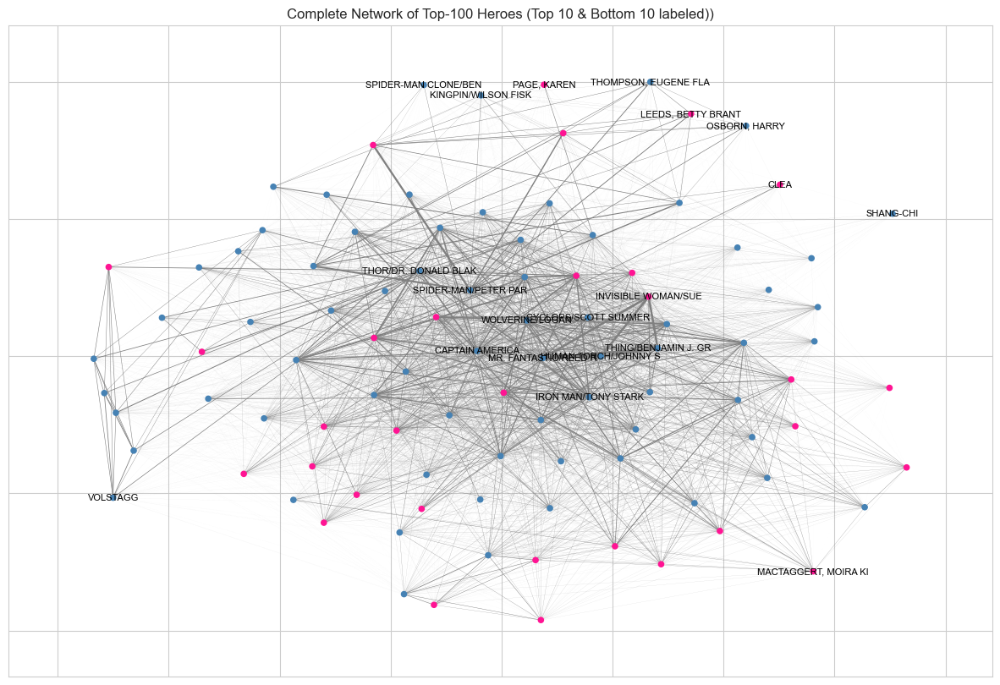

In [143]:
path = 'graphs/one_mode_top100_heroes/'
if not os.path.exists('graphs/one_mode_top100_heroes/'):
    os.makedirs(path)
full_graph = filter_one_mode_network(0, with_color = 'node', with_labels=True, save_graph= path + "full_graph")[0]

#### Network nodes and edges
We can see at the center of the network the edges are very thick, which indicated these heroes appear frequently together. At the fringes of the network some heroes appear to not have any connections; so they only associate rarely with the top100.
Looking at the bottom 10 nodes we labeled, these names don't necessarily seem to be heroes: For example Kingpin is usually rather considered a villain than a hero, and some of the others are just normal people that might be friends with the alter-ego of an hero.
In the center of the network we have labeled the Top10 heroes by number of edges. Unsurprisingly, these are the big names that are well known: Spider-Man, Iron Man, Captain America and Thor from the Avengers. Also we see the Fantastic Four and some members of the X-Men.


#### Network metrics
In the unfiltered network, we have 100 nodes and 4024 edges - so on average, each hero has 4 edges. Of course this is not really true as we have seen in the eda; some heroes are way better connected than others. We also have a graph density of 0.81, which is quite high. This indicated that all heroes are quite well connected between each other.
We also have a very high Cluster Coefficient of 0.88. Apparently, the network is tightly interwoven.
Neither of those results are surprising, given that we did not remove any edges yet - so even if heroes only appear together in one comic book, they are still connected. Next up we will repeat the process and keep removing edges to see what the effect on the network is.


### 2.2.2 Filtering the network by co-appearances
To determine which thresholds we should try, we will look at the distribution of co-appearances:

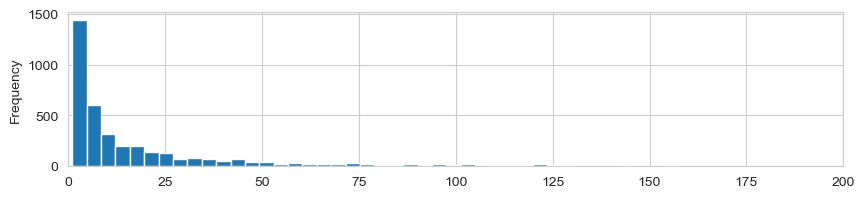

,count_co_appearance,rank_edges
count,4024.000000,4024.000000
mean,28.213718,30609.152336
std,57.396654,41295.482752
min,1.000000,2.000000
25%,3.000000,2283.750000
50%,8.000000,10916.500000
75%,27.000000,43397.000000
max,744.000000,165666.000000


In [144]:
plt.figure(figsize= (10,2))
network_top_100.count_co_appearance.plot(kind = 'hist', bins = 200)
plt.xlim(0, 200)
plt.show()

network_top_100.describe()

As most heroes seem to have co-appearances between 3 - 27, we will plot the network for all the quantiles. Additionally, we will also try 50 and 100, to see when we start loosing too much information.

Metrics for One-Mode Hero Network with threshhold 3
Number of nodes: 100
Number of edges: 3082
Density: 0.62
Cluster Coefficient: 0.81


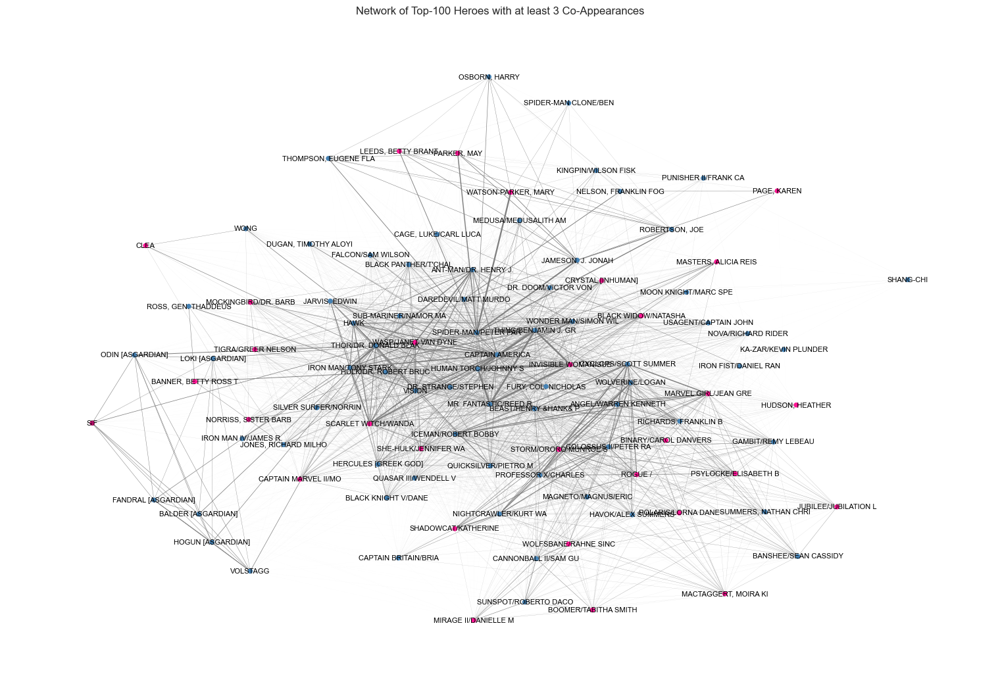

Metrics for One-Mode Hero Network with threshhold 8
Number of nodes: 100
Number of edges: 2078
Density: 0.42
Cluster Coefficient: 0.79


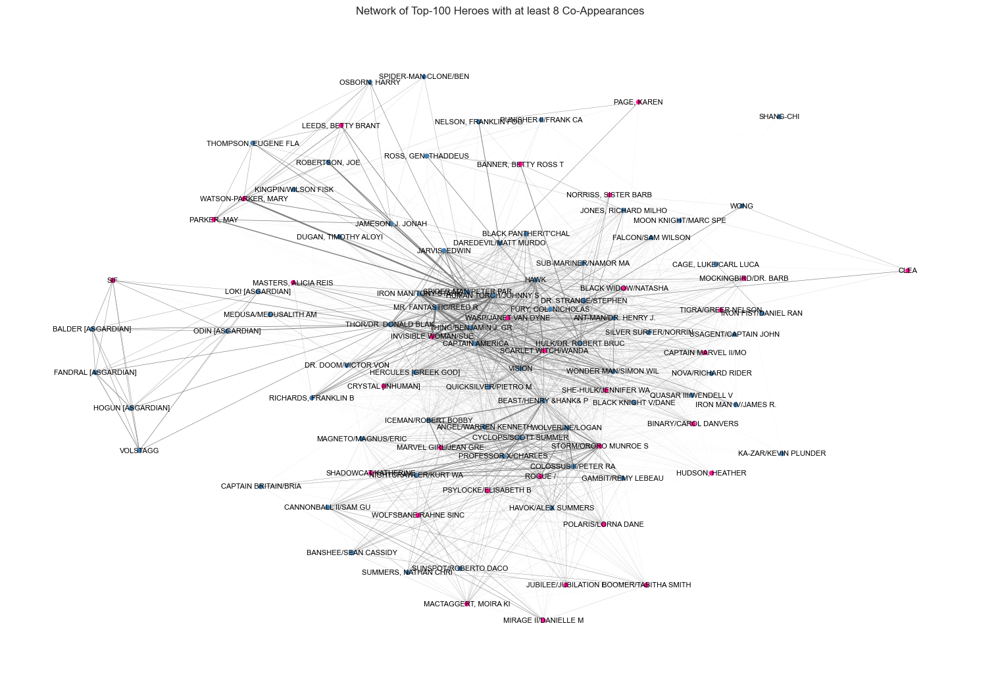

Metrics for One-Mode Hero Network with threshhold 27
Number of nodes: 100
Number of edges: 1011
Density: 0.2
Cluster Coefficient: 0.75


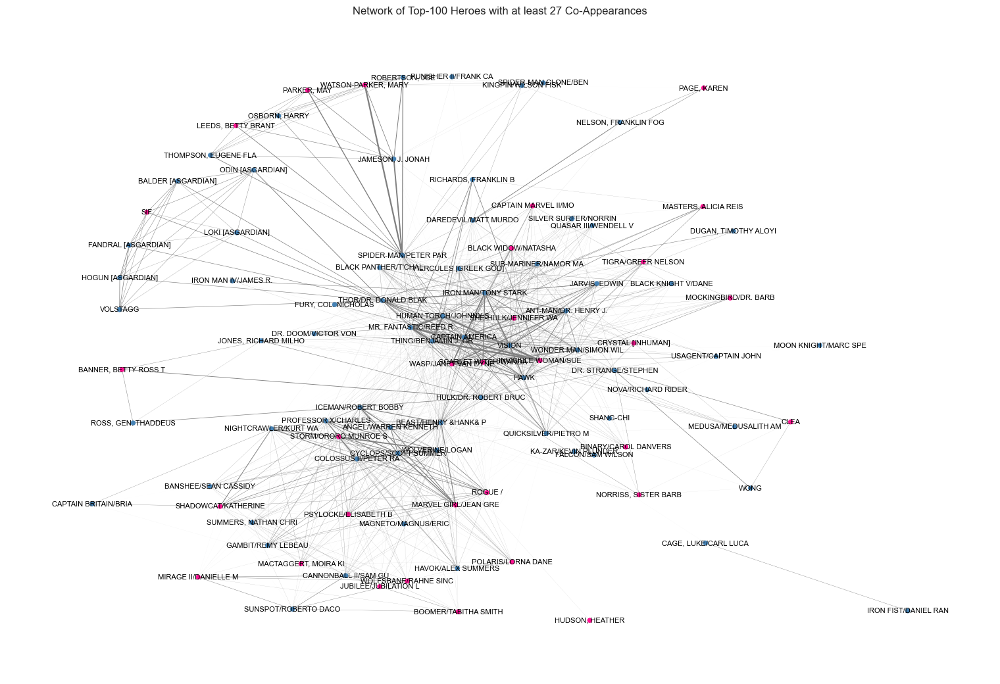

Metrics for One-Mode Hero Network with threshhold 50
Number of nodes: 100
Number of edges: 597
Density: 0.12
Cluster Coefficient: 0.71


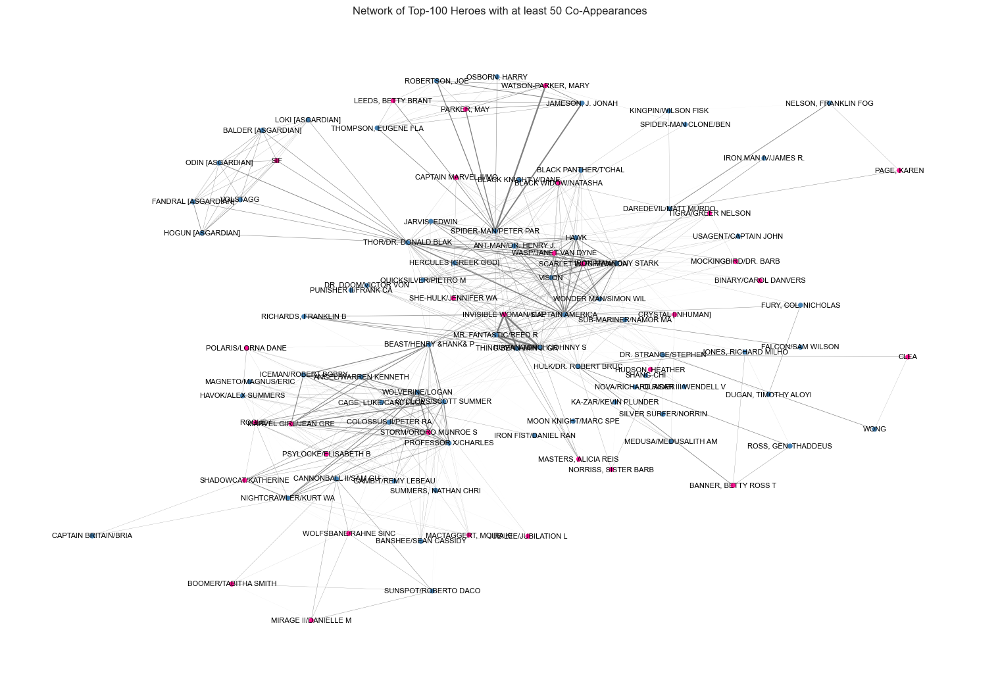

Metrics for One-Mode Hero Network with threshhold 100
Number of nodes: 100
Number of edges: 278
Density: 0.06
Cluster Coefficient: 0.59


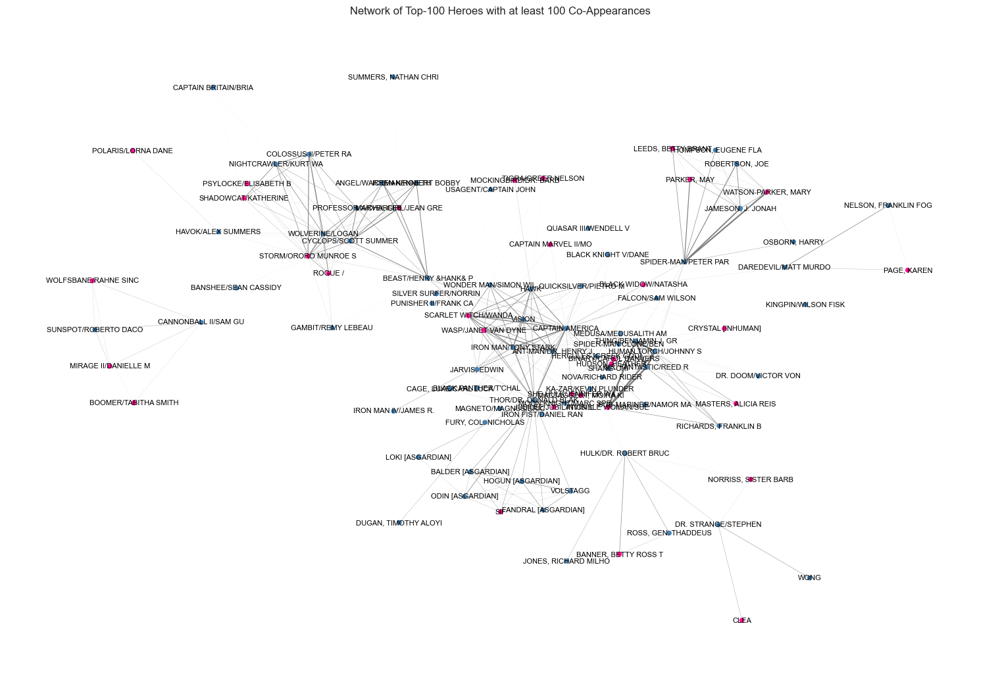

In [145]:
path = 'graphs/one_mode_top100_heroes/2_network_reduction/'
if not os.path.exists(path):
    os.makedirs(path)

all_stats = pd.DataFrame()
for co_appearance in [3,8,27,50,100]:
    stats = filter_one_mode_network(co_appearance, with_color = 'node', with_labels=True, save_graph= path + f"graph_heroes_{co_appearance}")[1]
    stats = pd.DataFrame(stats, index=[0])
    all_stats = pd.concat([all_stats, stats], ignore_index=True)

As we can see in the graphs, we lose about 1000 edges per increase of threshold. The more edges we remove, the more groups are popping up quite clearly. We have the Fantastic Four (Mr. Fantastic, Human Torch, Thing, Invisible Woman) with some very thick edges and seemingly almost no connections to the rest of the network. Another large group seems to be the X-Men (Cyclops, Professor X, Storm, Beast, Jean Grey, Angel, Iceman). In the center of our network, we can still spot Captain America and Spider-Man, as was expected from our priliminary analysis of the edges and network file. We can also see some other members of the Avengers. Additionally, there seems to be a group made up of Asgardians that are closely connected.

#### Who is holding all the strings?
If we focus our attention on the plot with the threshhold of 27 co-appearances, we can already identify potential brokers and their associated groups by their position in the network:
- For the Asgardians, all connections to other heroes seem to go via Thor
- For people in the Spiderverse, the broker is (obviously) Spider-Man
- For the X-Men, most connections seem to be made through Beast. When we heighten the threshold to 100, a subgroup seems to appear that has Cannonball as their chosen contactperson.
- Interestingly, even though Captain America is at the center of the network, he doesn't seem to be in a broker position, since all heroes surounding him have solid connections between themselves. We will analyse this further by calculating the actor betweenness centrality later on.

#### And what about the women?
So what about our heroines? As we know, about one third of our nodes are female heroes. In the network, most of them appear in the X-Men group. Only very few are in the center of the network. We will take a look at the connections between genders in our next step.

#### Statistics: Density and Cluster Coefficient

,threshhold,nodes,edges,density,cluster_coeff
0,3.0,100.0,3082.0,0.62,0.81
1,8.0,100.0,2078.0,0.42,0.79
2,27.0,100.0,1011.0,0.20,0.75
3,50.0,100.0,597.0,0.12,0.71
4,100.0,100.0,278.0,0.06,0.59


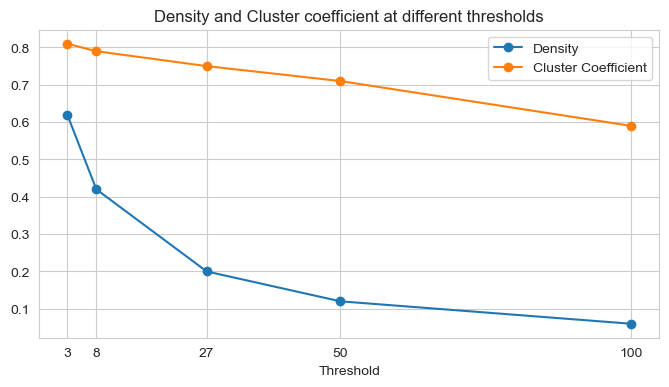

In [146]:
display(all_stats)

plt.figure(figsize = (8,4))
plt.plot(all_stats['threshhold'], all_stats[['density', 'cluster_coeff']], marker='o')
plt.xlabel('Threshold')
plt.xticks(ticks = all_stats.threshhold)
plt.legend(['Density', 'Cluster Coefficient'], loc='upper right')
plt.title('Density and Cluster coefficient at different thresholds')
plt.show()


As for the network metrics, the density droppes almost instantly once we remove edges. At the median of 8, our density is already down to 0.42. By 100, it is down to a measly 0.06. So it seems that while in general, most heroes have been in contact with other heroes at some point in their storylines, a lot of these contacts were brief, spanning less than 30 comic book issues. This is of course concurrent with the distribution of co-appearances.
The Cluster Coefficient stays quite high: even at the highest threshold of 100, it is still 0.59. This indicates that all heroes in the network are at least locally well connected, even if they might not be well connected with everyone else in the network.



#### Conclusion: which thresholds will we use?
From the plots above we will pick the threshhold 8, 27 and 50 as filtered datasets. All offer a more manageable edge count, while still maintaining a lot of information.



### 2.2.2 Plotting with gendered edges
Next, we will plot the 3 chosen networks with colored edges to see how the connections are: are there many female to female edges or are they rare?


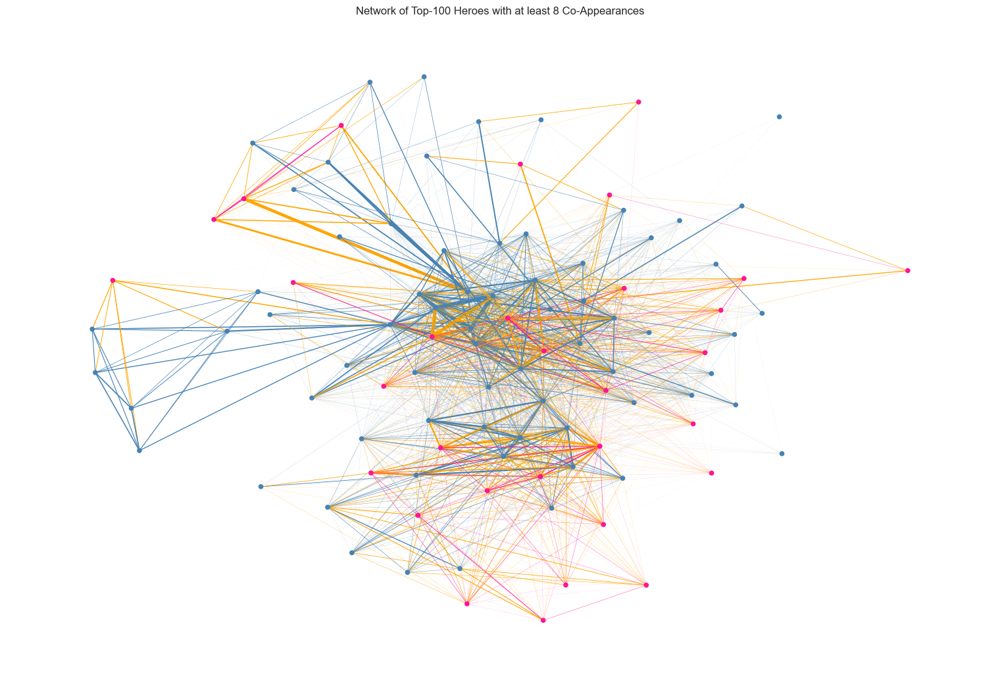

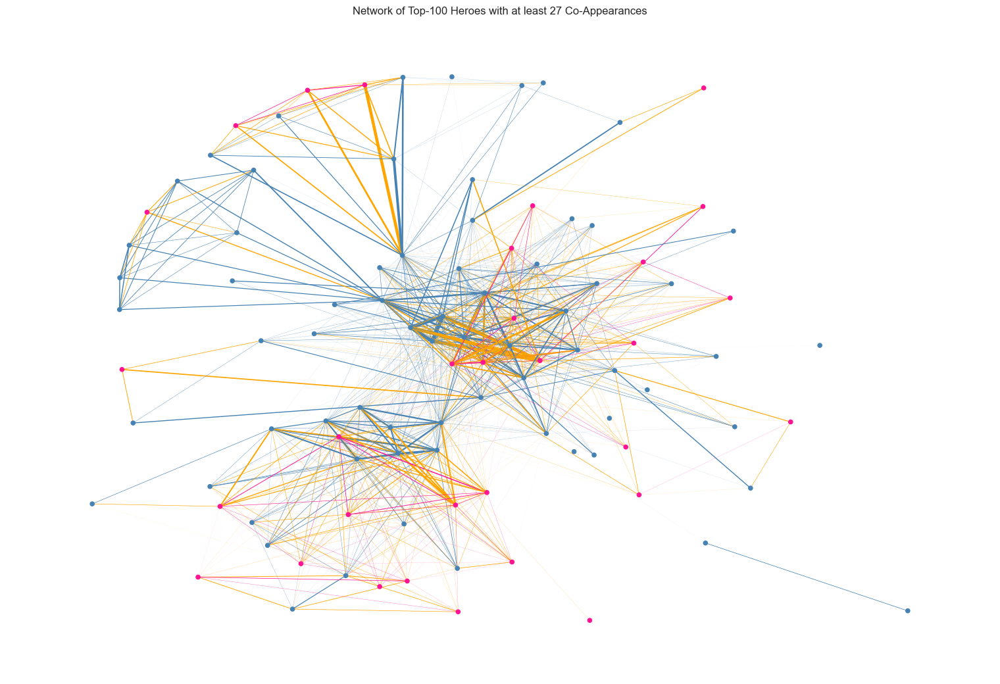

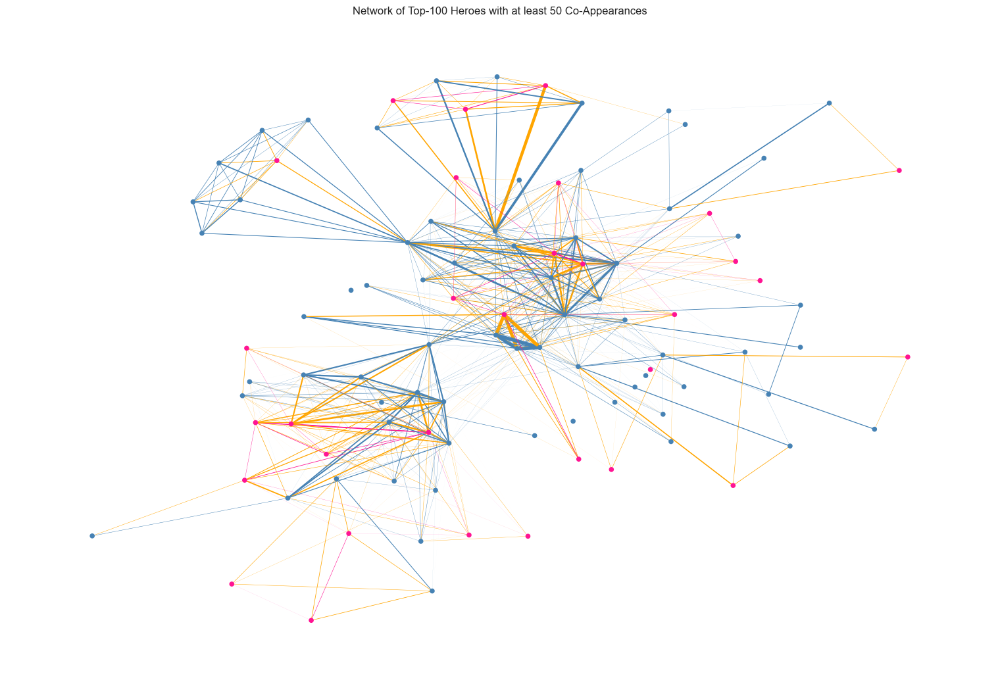

In [147]:
graph_heroes_8 = filter_one_mode_network(8, with_labels = False, plot_graph = True, with_color = 'both', edge_width_factor = 2, print_information=False)[0]
graph_heroes_27 = filter_one_mode_network(27, with_labels = False, plot_graph = True, with_color = 'both', edge_width_factor = 2,print_information=False)[0]
graph_heroes_50 = filter_one_mode_network(50, with_labels = False, plot_graph = True, with_color = 'both', edge_width_factor = 2,print_information=False)[0]


As we can see, the edges for all networks are both predominantly orange, or blue. Pink edges are not as frequent. However, it seems like most graphs that look like subgroups (because they connect to the rest of the network mainly via one node, which we will analyse a bit more in the actor centrality analysis) feature at least one woman. There seems to be no group that is entirely male. On the other hand, we also don't spot any exclusively pink structures, which indicates that female only teams are not a thing in our reduced network.


In [148]:
for graph in [graph_heroes_8, graph_heroes_27, graph_heroes_50]:
    print(f"{graph.name}:")
    print(f' Number of female nodes: {len([(u, v) for u, v, e in graph.edges(data=True) if e["gender"] == "f-f"])}')
    print(f' Number of male nodes: {len([(u, v) for u, v, e in graph.edges(data=True) if e["gender"] == "m-m"])}')
    print(f' Number of mixed nodes: {len([(u, v) for u, v, e in graph.edges(data=True) if e["gender"] not in ["m-f", "f-m"]])}')

One-Mode Hero Network with threshhold 8:
 Number of female nodes: 161
 Number of male nodes: 1066
 Number of mixed nodes: 1227
One-Mode Hero Network with threshhold 27:
 Number of female nodes: 78
 Number of male nodes: 516
 Number of mixed nodes: 594
One-Mode Hero Network with threshhold 50:
 Number of female nodes: 45
 Number of male nodes: 307
 Number of mixed nodes: 352


Our visual impression of the network was indeed correct; in either network the male-to-male edges outnumber female-to-female almost 10 times, and the orange ones are the most dominant. So it seems there is not that much of girl power action in the comics, instead women are usually just part of a mixed team. This might also be due to the fact that our network is limited to the top100 heroes and most of them are males.

# 3 Network Subgroups analysis
To try to identify the groups, we will use 3 different algorithms: clique detection, k-core and Girvan-Newman.


## 3.1 Cliques

A clique is indeed a closely connected group. Every hero in a clique is directly connected to every other hero in the same clique.
We will exclude the cliques with size of 2 (also known as dyads), as it may not provide meaningful insights in our case.

### 3.1.1 How many closely connected groups (cliques) exist in our selected hero social network? and how large are the groups?
For this analysis, we will use the graph_50 network, as we would otherwise end up with a lot of cliques as our network is very dense.

Number of cliques in the network: 78
Number of nodes in each clique: [14, 14, 14, 13, 13, 13, 12, 12, 12, 12, 12, 12, 12, 12, 11, 10, 10, 10, 10, 9, 9, 9, 9, 9, 9, 9, 9, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 7, 7, 7, 7, 6, 6, 6, 6, 6, 6, 5, 5, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]


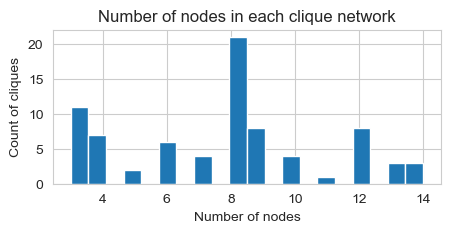

In [149]:
G = graph_heroes_50
cliques = list(nx.find_cliques(G))
# Remove cliques of size 2
cliques = [clique for clique in cliques if len(clique) > 2]
cliques = sorted(cliques, key = lambda x: len(x), reverse = True)
print(f"Number of cliques in the network: {len(cliques)}")

cliques_len = [len(clique) for clique in cliques]
print(f"Number of nodes in each clique: {cliques_len}")
plt.figure(figsize = (5,2))
plt.hist(cliques_len, bins = 20)
plt.xlabel("Number of nodes")
plt.ylabel("Count of cliques")
plt.title("Number of nodes in each clique network")
plt.show()


As we can see, we have quite a lot of cliques in our network. From the histogram, we see that the size of the cliques are quite distributed; with the smallest ones containing 3 members and the biggest one 14.
### 3.1.2 Which heroes are involved in most closely connected groups (cliques)?

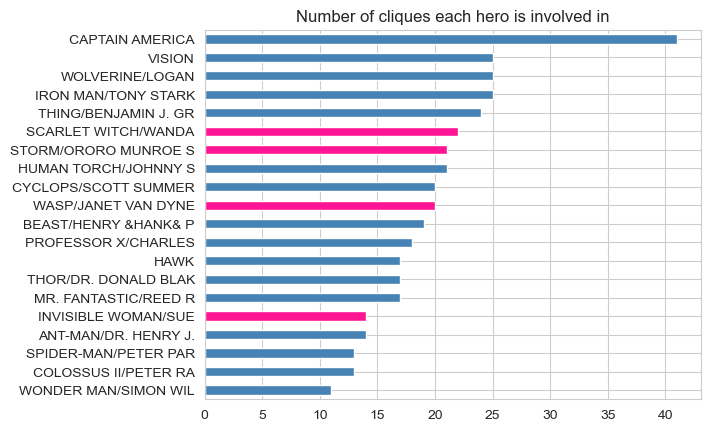

In [150]:
cliques_nodes = [node for clique in cliques for node in clique]
cliques_nodes_count = pd.Series(cliques_nodes).value_counts()
node_colors = ['deeppink' if node in female_heroes else 'steelblue' for node in cliques_nodes_count.index]
cliques_nodes_count.nlargest(20).plot(kind = 'barh', title = 'Number of cliques each hero is involved in', color = node_colors)
plt.gca().invert_yaxis()
plt.show()

We can see that Captain America is involved in 40 cliques, which is over half of all the cliques (78)! He seems to like to dance at every party.
Other than him, the rest are the usual suspects we have seen in all our top lists, including all the women. Here it is interesting that Storm is part of more cliques than other X-Men (except Wolverine). Invisible Woman is quite low in the list, lower than all other Fantastic Four members. So, again, it appears she is less well connected than her male teammembers, despite them being conceptionalized as a team from the get-go.

### 3.1.3 Are there also loners who don't seem to belong to any closely connected group, or only to very small ones?

In [151]:
heroes_in_clique = list(set([node for clique in cliques for node in clique]))

heroes_not_in_clique = [name for name in top_100_heroes if name not in heroes_in_clique]
print(f"{len(heroes_not_in_clique)} heroes are not in any closely connected groups (cliques).")
hero_nodes[hero_nodes['hero'].isin(heroes_not_in_clique)].reset_index(drop = True)

9 heroes are not in any closely connected groups (cliques).


,hero,count_appearance,rank,gender
0,PUNISHER II/FRANK CA,299,46,m
1,"CAGE, LUKE/CARL LUCA",232,65,m
2,FALCON/SAM WILSON,221,70,m
3,IRON FIST/DANIEL RAN,199,77,m
4,MOON KNIGHT/MARC SPE,187,83,m
5,KA-ZAR/KEVIN PLUNDER,176,88,m
6,NOVA/RICHARD RIDER,174,91,m
7,SHANG-CHI,174,93,m
8,"HUDSON, HEATHER",172,94,f


In our network we have 9 heroes that don't appear to be part of a clique. Let's dive into Marvel lore to see if we can find out why:
- **Punisher** is an Anti-Hero - no surprise no one wants to be friend with a vigilante / murderer
- **Luke Cage** doesn't like to be a hero and tries to keep a low profile. Technically he and Iron Fist are part of a superhero group called "The Defenders" but potentially our limitation to the top 100 has removed the other members of this group, therefore leaving these 2 as by themselves.
- **Falcon** has spent some time in team Avengers. However, it is possible that with our filtering the number of co-appearances with Avengers hero was not high enough to identify him as a teammember.
- **Iron Fist** as already mentioned; technically belongs to a group, but probably is missing the other members.
- **Moon Knight** is not based in America, where most superhero teams are. Also, he has DID so he is technically his own clique.
- **Ka-Zar** also is not based in the US and is the "Protector of the Savage Land". Given his job title, it makes sense that he'd rather keep to his territory.
- **Nova** seems to be part of Spider-Mans circle of associates, but seems to not have many connections to others. As such, it is not enough to be part of a clique.
- **Shang-chi** is formerly from China. As such, his circle of affiliates are mostly stand-alone, without many tie ins to american heroes.
- **Heather Hudson** is affiliated with X-Men - it's not quite clear why she was singled out and not identified as part of a clique. It might be because she is not well connected to all members of the X-Men, but mostly to Wolverine.

### 3.1.4 Which two heroes have appeared most frequently in the same cliques?

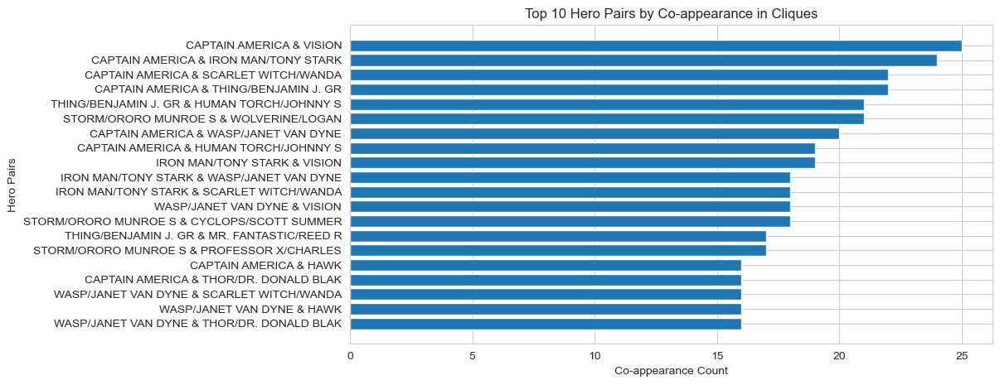

In [152]:
coappearance_in_clique = Counter()

for clique in cliques:
    # This will create all unique pairs (combinations) of heroes within each clique
    for pair in combinations(clique, 2):
        coappearance_in_clique[pair] += 1

# Sort the pairs by count in descending order
sorted_pairs = sorted(coappearance_in_clique.items(), key=lambda pair: pair[1], reverse=True)

# Prepare data for plotting
pairs = [f"{pair[0]} & {pair[1]}" for pair, count in sorted_pairs]
counts = [count for pair, count in sorted_pairs]

# Plot
plt.figure(figsize=(10, 5))
plt.barh(pairs[:20], counts[:20])  # Top 20 pairs
plt.xlabel('Co-appearance Count')
plt.ylabel('Hero Pairs')
plt.title('Top 20 Hero Pairs by Co-appearance in Cliques')
plt.gca().invert_yaxis()  # Invert y-axis to show the highest count on top
plt.show()

If heroes associate frequently together in different cliques it could indicate that they are friends. In our plot, we see that Captain America seems to be best friends with a lot of other heroes - almost all couplings feature him. Given the amount of cliques he is in this is not really a surprise -it's hard to avoid a person that is involved in half of all groups.

We can also see here a difference in genders: Invisible Woman is part of a 4-people team, but while all other members of her team appear in this list (though only in combination with Thing - Human Torch & Mr. Fantastic do not appear to be as close), she is not here. This indicates that even though she is part of her own team, she does not join them when they star in other series and help other people. Also, we see almost no female only coupling (the only one is Wasp & Scarlet Witch).

### 3.1.5 Are well-known hero groups (Avengers, Fantastic Four, X-men) also recognizable in the cliques?


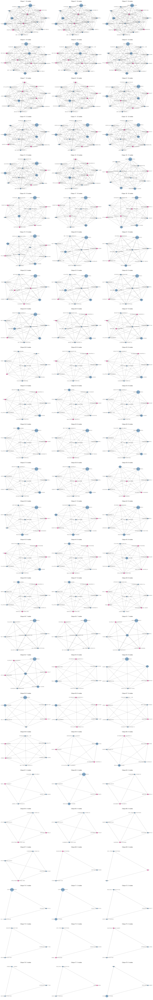

In [153]:
"""
Usage of Chat-GPT: To plot clique graphs.
"""
top1_lst = cliques_nodes_count.nlargest(1).index
top234_lst = cliques_nodes_count.nlargest(4).index[1:]

# Create subgraph of the cliques
graphs_per_row = 3
rows = len(cliques) // graphs_per_row + (1 if len(cliques) % graphs_per_row else 0)
fig, axes = plt.subplots(nrows=rows, ncols=graphs_per_row, figsize=(20, rows*5))
axes = axes.flatten()

path = 'graphs/one_mode_top100_heroes/3.1_cliques/'
if not os.path.exists(path):
    os.makedirs(path)
# Plot each clique as a graph and save it as a gexf file
for i, clique in enumerate(cliques):

    clique_graph = G.subgraph(clique)
    node_colors = ['deeppink' if node in female_heroes else 'steelblue' for node in clique_graph.nodes()]
    node_sizes = [1000 if node in top1_lst else 500 if node in top234_lst else 100 for node in clique_graph.nodes]
   
    pos = nx.spring_layout(clique_graph, seed=42)
 
    nx.draw(clique_graph, pos=pos, ax=axes[i], with_labels=True, node_color=node_colors, node_size = node_sizes, font_size = 10, alpha = 0.6, edge_color = 'grey')
    axes[i].set_title(f'Clique {i+1}: {str(len(clique))} nodes')
    # save clique graph
    nx.write_gexf(clique_graph, path + f'clique_{i}.gexf')

# Drop empty plots 
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


plotting the cliques we see a huge overlap in a lof of them. It seems a lot of cliques are the same kind of people, with just minimal shuffling of some members.

However, we can identify some of the groups in the cliques:
- Group 1 consists of Avengers, Fantastic Four and, for some reason, She-Hulk
- The X-Men appear in various constellations, for example in groups 7-9, but also in almost every group size there is some variation of the X-Men present. Given that they are a huge group this is not really surprising.
- Groups 10 - 12 are the Avengers again, this time sans Fantastic Four (but still featuring She-Hulk)
- The Asgardian delegation is depicted in group 28.
- Funny enough, the Fantastic Four are not depicted in any of the four node groups. The closest we get is group 58, with 2 extra nodes: Alicia Reis Masters and Franklin B Richards.

## 3.2 k-core subgroups

Next we will try to detect communities with k-core subgroups. As we have a network with a lot of connections between heroes, we will try different ks to see how many groups we can find.

In [154]:
"""
Usage of Chat-GPT: To help debugging the graph display
"""

def plot_k_core_subgraphs(G, k, display_all=True, with_labels=False, save_plot=True):
    """
    Plots the k-core subgraphs for the given graph within a specified range.
    
    G: A NetworkX graph
    k: k values for which the k-cores should be plotted
    display_all: Boolean flag to plot all nodes or only k-core nodes
    """
    # Find k-cores in the graph for the specified range
    k_core_subgraph = nx.k_core(G, k)
    if k_core_subgraph.number_of_nodes() > 0:
        plt.figure(figsize=(12, 6))

        pos = nx.spring_layout(G, seed=42)  # Use the full graph for consistent node positions
            
        if display_all:
            plt.figure(figsize=(20, 15))
            pos = nx.kamada_kawai_layout(G)
            nx.draw_networkx_nodes(G, pos, node_size=20, node_color='lightgrey')
            nx.draw_networkx_edges(G, pos, edge_color='lightgrey', alpha=0.4)

        # Highlight the k-core nodes and edges
        node_colors = ['deeppink' if node in female_heroes else 'steelblue' for node in k_core_subgraph.nodes()]
        gender_colors = {'m-m': 'steelblue', 'f-f': 'deeppink'}

        if with_labels and k_core_subgraph.number_of_nodes() >= 30: # Only show labels of the top 10 nodes
            top_10_nodes = sorted(G.degree, key=lambda x: x[1], reverse=True)[:10]
            print(top_10_nodes)
            node_labels = {node: node for node, _ in top_10_nodes}
            nx.draw(k_core_subgraph, pos, edge_color=[gender_colors.get(k_core_subgraph.edges[edge]['gender'], 'orange') for edge in k_core_subgraph.edges()], width=0.6, node_color=node_colors, node_size=50, font_size=8, alpha = 0.4)
            nx.draw_networkx_labels(G, pos, font_size=8, labels=node_labels)
            plt.title(f"{k}-Core subgraph of top 100 heroes: {k_core_subgraph.number_of_nodes()} heroes (top 10 labeled)")
            plt.show()
    
        else:
            nx.draw(k_core_subgraph, pos, edge_color=[gender_colors.get(k_core_subgraph.edges[edge]['gender'], 'orange') for edge in k_core_subgraph.edges()], width=0.6, node_color=node_colors, node_size=50, font_size=8, alpha = 0.4)
            nx.draw_networkx_labels(G, pos, font_size=8)
            plt.title(f"{k}-Core subgraph of top 100 heroes: {k_core_subgraph.number_of_nodes()} heroes")    
            plt.show()
        # save k-core subgraph
        if save_plot:
            nx.write_gexf(k_core_subgraph, path + f'{k}_core_subgraph.gexf')
    



<Figure size 1200x600 with 0 Axes>

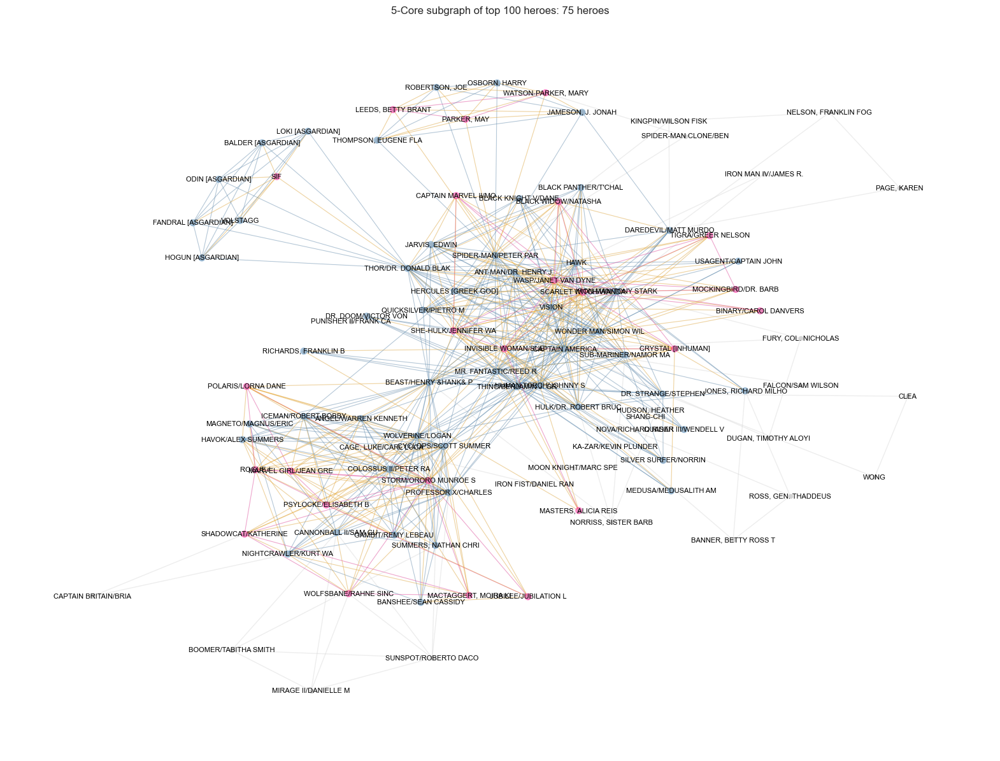

<Figure size 1200x600 with 0 Axes>

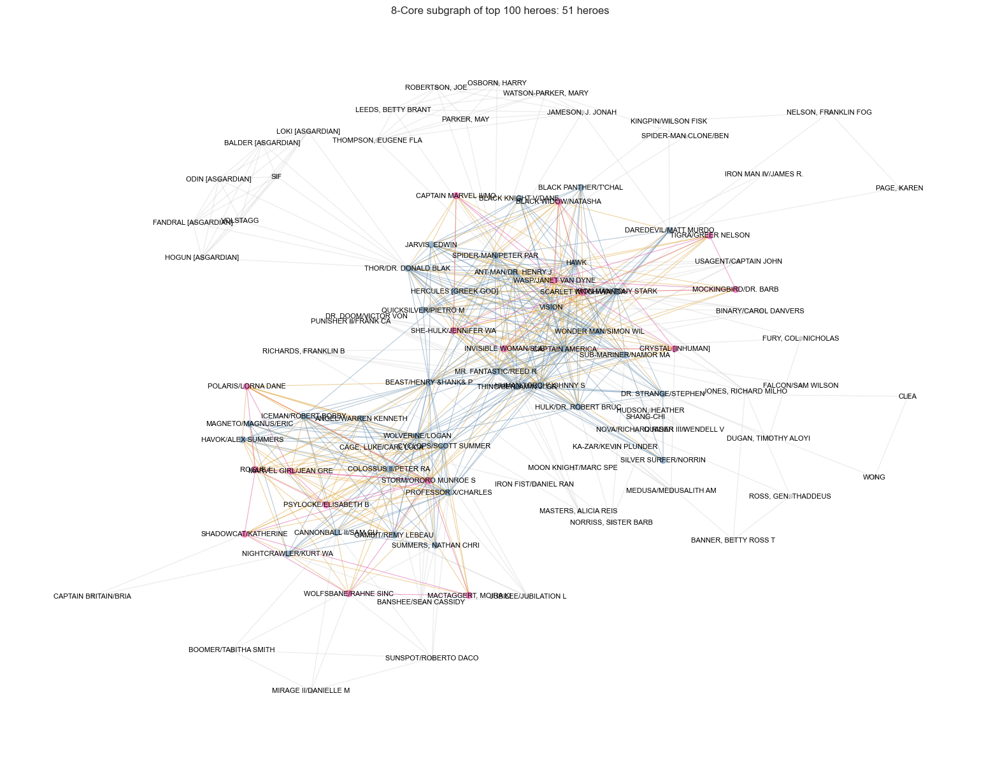

<Figure size 1200x600 with 0 Axes>

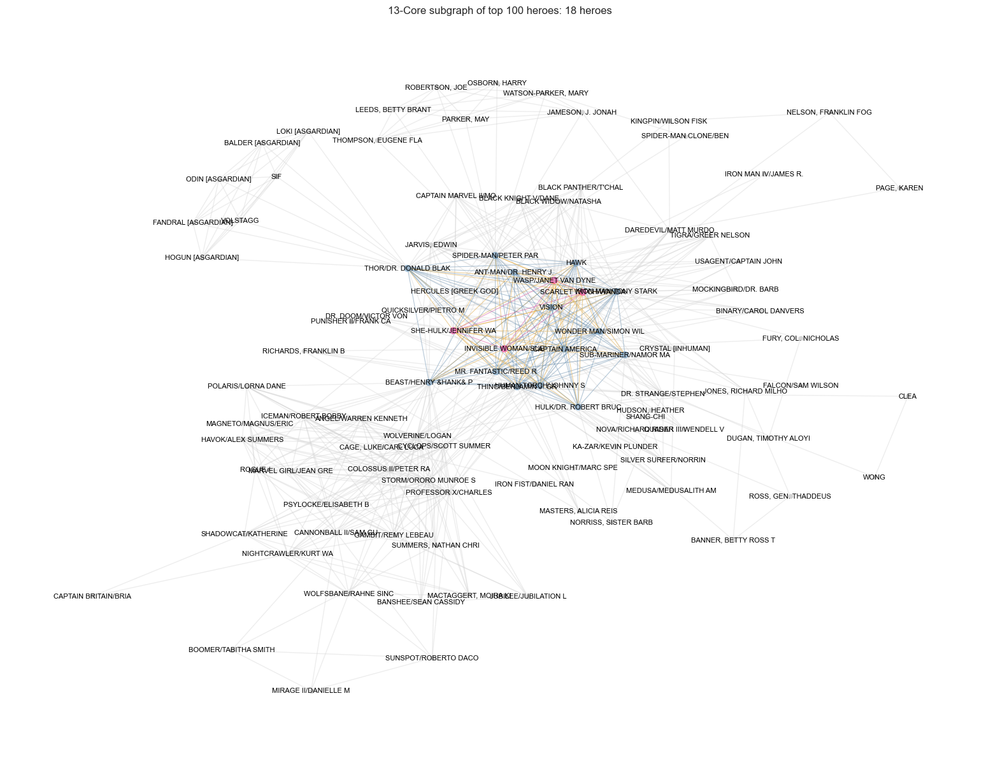

In [155]:
path = 'graphs/one_mode_top100_heroes/3.2_k_core/'
if not os.path.exists(path):
    os.makedirs(path)
    
G = graph_heroes_50
for k in [5, 8,13]:
    plot_k_core_subgraphs(G, k, display_all=True, with_labels = False)

From our k-core plots we can see just how tightly all heroes are connected with each other:
-   At k = 5, we have practically the whole network as one group.
-   At k = 8, we start to see the first groups drop off: these are the Asgardians, the people connected via Spider-Man and those that are connected via DareDevil.
    This confirms once more that certain members of the inner core / the Avengers are really all that is tying these individual networks together, as there are no other bridges. At this level we also see that the X-Men are well connected with the inner group - it seems they have a lot of co-appearances with all kinds of people.
-   At k = 13 we are reduced to the 18 core heroes: Most of which are members of the Avengers, or part of the Fantastic Four.


## 3.3 Community detection using Girvan Newmann
Last, we will try to create communities using the Girvan Newman algorithm.

In [183]:
""" Usage of Chat-GPT: Chat-GPT was used to plot the network, mainly for the coloring of the nodes. """

def plot_girvan_newman(n_steps, G, save_plot = False):
    edge_betw_communities = community.girvan_newman(G)

    for i in range(n_steps-1):
        communities = next(edge_betw_communities)

    color_map = {}
    for i, comm in enumerate(communities):
        for node in comm:
            color_map[node] = i

    plt.figure(figsize=(15, 12))
    pos = nx.kamada_kawai_layout(G)
    nx.draw_networkx_nodes(G, pos, node_color=[color_map.get(node, -1) for node in G.nodes()], cmap=plt.cm.tab20,alpha = 0.6, node_size=50)
    nx.draw_networkx_edges(G, pos, alpha=0.4, edge_color = 'lightgray')
    nx.draw_networkx_labels(G, pos, font_size=8)
    plt.title(f'Communities after {n_steps} steps using Girvan-Newman')
    if save_plot:
        plt.savefig(path + f'girvan_newman_{n_steps}_steps.png')
    plt.show()


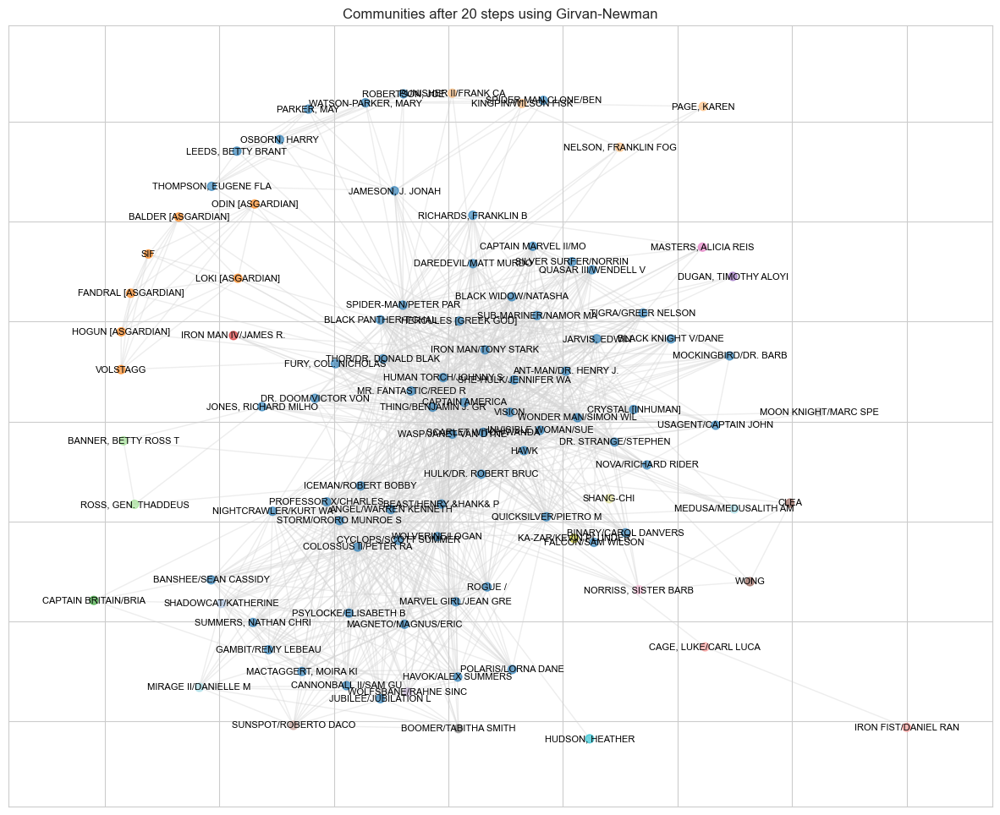

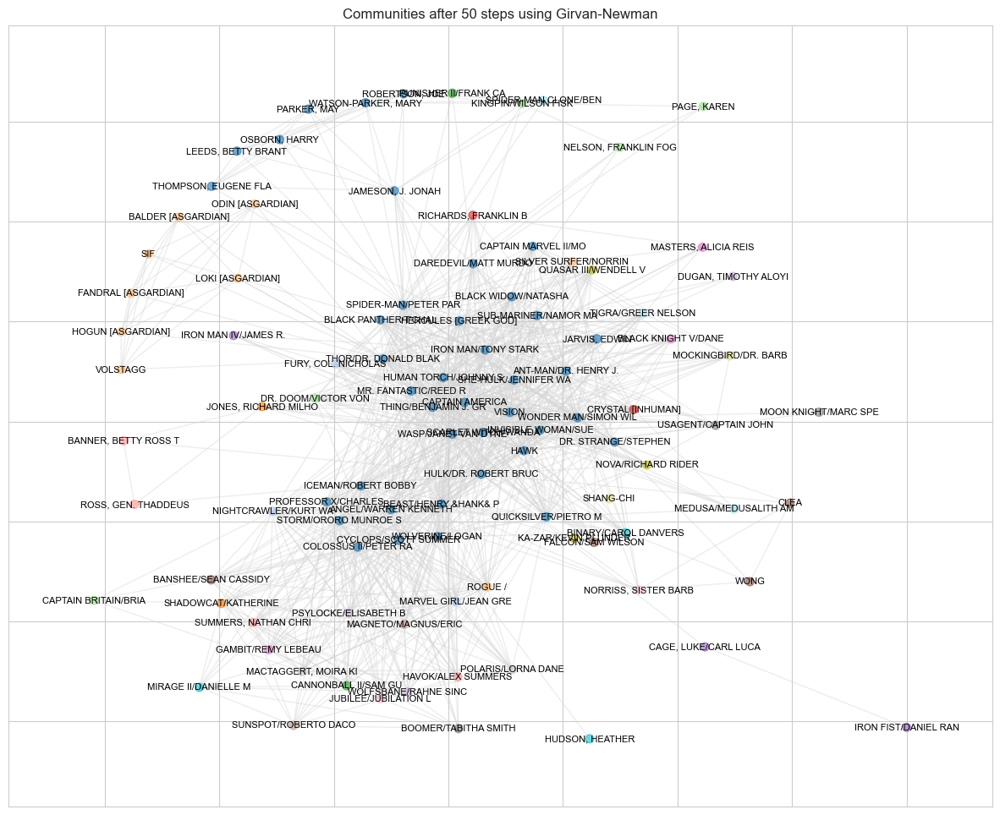

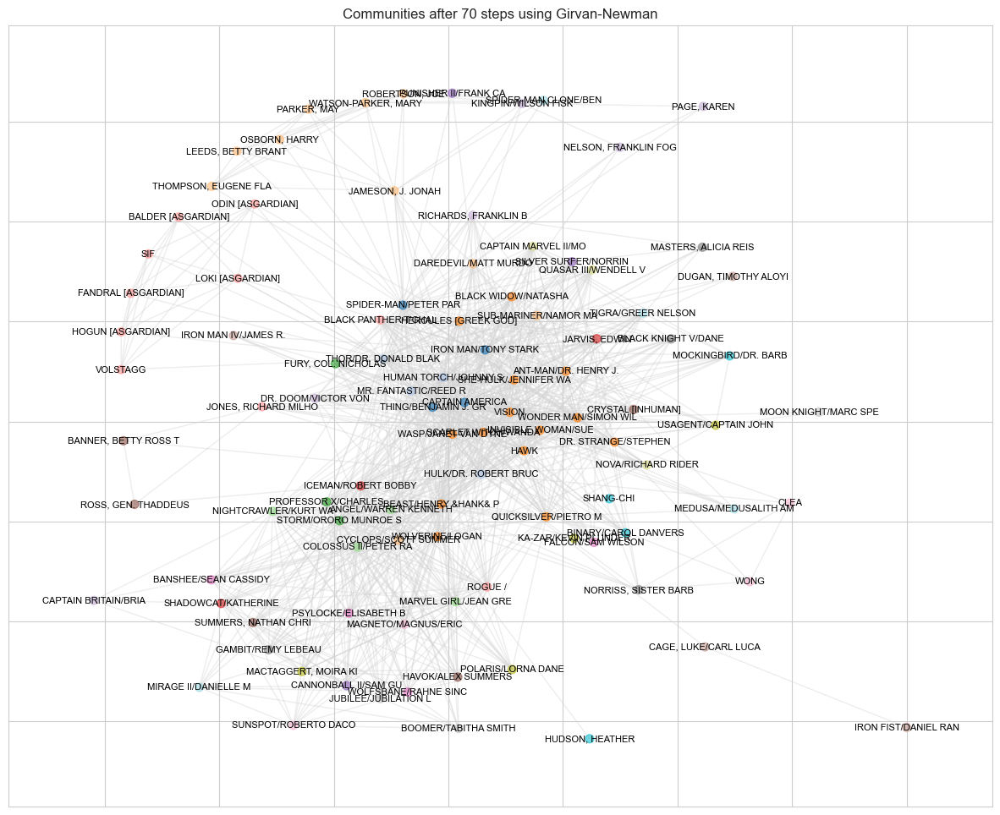

In [184]:
G = graph_heroes_27
for n in [20,50,70]:
    plot_girvan_newman(n, G)

For our graph_27_network, Girvan-Newman did not work well:
After 20 iterations only the Asgardians emerge as their own group, while most of the network remains blue.

After 50 iterations of the algorithm, we end up with quite a few groups - but not really the ones we expected. The whole center of the network is still considered one group, so it is unalbe to sus out the Fantastic Four from the Avengers. The X-Men also don't really appear as one cohesive group, instead, most of them are in the big center group and the rest more or less fend for themselves.

After 70 steps the algorithm goes to far and starts to split up the Avengers into subgroups, with Captain America running off with Thing and Iron Man to do their own thing, while the rest of the team incorporated some X-Men such as Beast and Wolverine. The other X-Men now have a center group formed of Nightcrawler, Professor X, Angel, Storm, Jean Grey and Colossus, while the rest is largely split into individuals.

We will repeat the process for our graph_hero_50. As there are less edges, we will alter our range for the steps down.


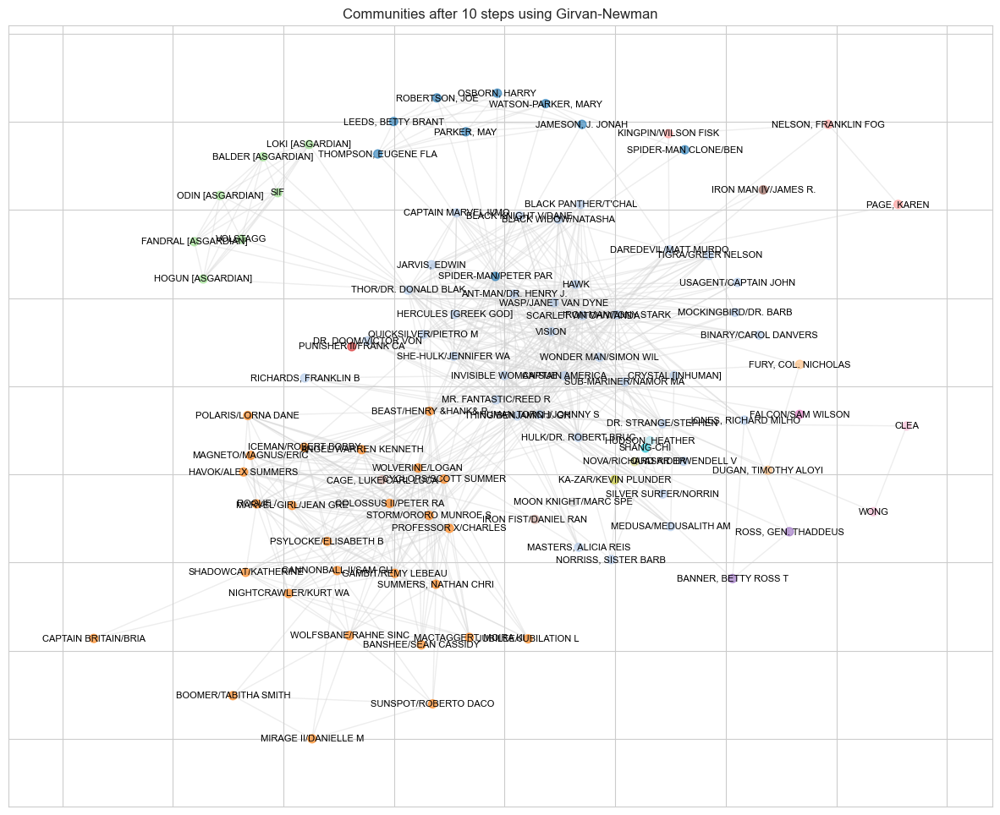

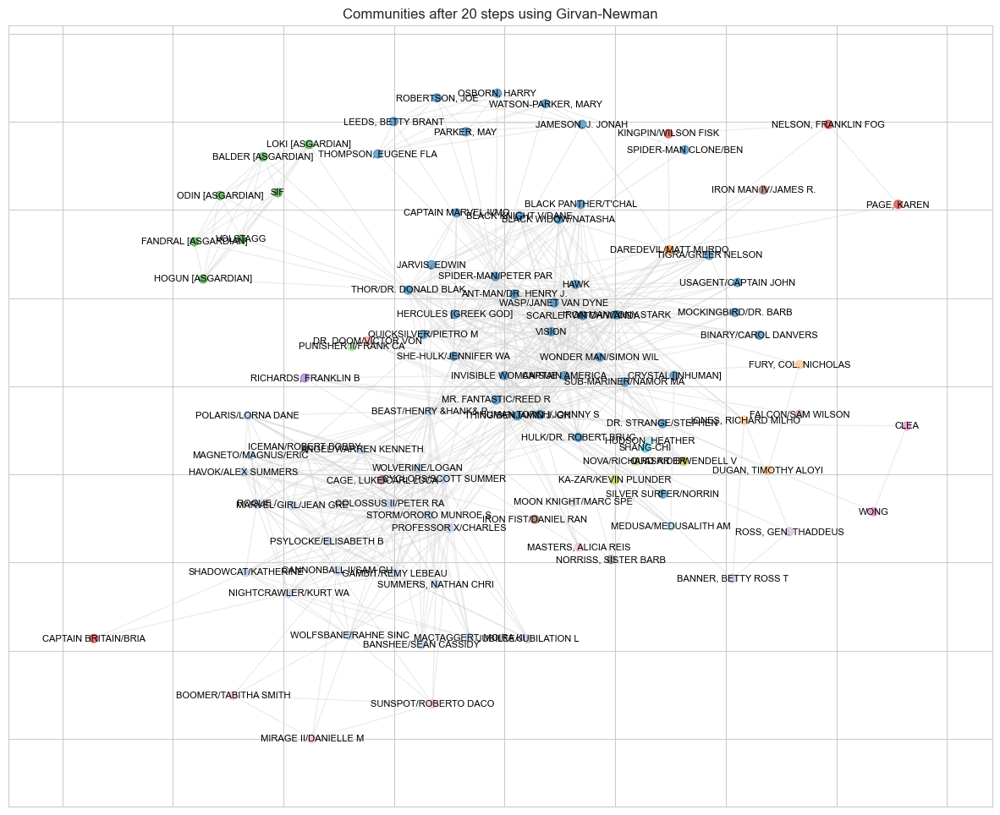

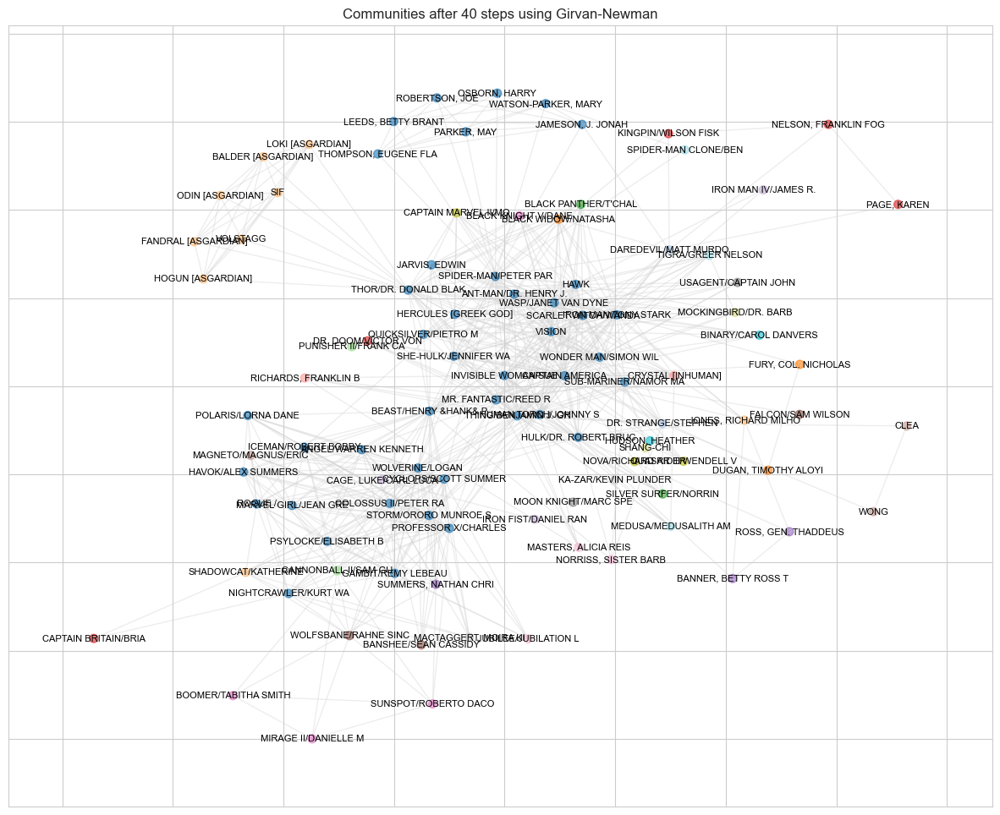

In [185]:
path = 'graphs/one_mode_top100_heroes/3.3_girvan_newman/'
if not os.path.exists(path):
    os.makedirs(path)

G = graph_heroes_50
for n in [10,20,40]:
    plot_girvan_newman(n, G, save_plot=True)

This time, we get much better grouping! After 10 steps, we already have a lot of groups correctly identified:
- Asgardians in green
- Spider-Man and his people in darkblue
- X-Men in orange

As usual, the algorithm is struggling with distinguishing between Fantastic Four and Avengers, but this result is already a lot better than with our previous graph.
With less edges the algorithm does overshoot quite quickly though; after 40 steps it has already done too much as well.


### Conclusion: Are the groups we expected actually visible in the network?
In all our 3 attempts, we were able to find subgroups. However, these subgroups are not necessarily the ones we expected:
Using the **cliques** function of networkx, we discovered a lot of cliques, but a most of them had a huge overlap.
Using **k-core**, we were able to nicely see the inner core of the Avengers, and that key figures such as Spider-Man and DareDevil are the only thing connecting their little universe to the whole marvel universe.
Using **Girvan-Newman**, with the graph_network_50, we were able to nicely see some of our groups.

So overall, the groups we expected to see are visible by looking at the graph and the edges, we were able to see as well in some of our clustering methods. However, we had to remove quite a few edges for it to work, as otherwise our network is too well connected - damn those huge crossover episodes where everyone meets everyone!

Next up we will look at individual actors to see which of them might be in influential positions, as well as analyzing which hero groups might be important.

# 4 Actor and group centrality analysis
To understand how and which heroes are central to the network, we will calculate the actor centrality for our selected heroes.

- Which heroes are brokers between groups?
- Which heroes are central in the network and thus are crucial for flow of information?
- Is there a hero group that acts as a connecting node between other groups?


## 4.1 Actor centrality

### 4.1.1 Which heroes are brokers / bridges between groups?
To find the brokers we will use the betweenness centrality, as this metric tells us how many edges go through one hero to reach other parts of the network. Or translated to our setting: Who are the heroes that act as contact point for other parts of the network. We would expect the heroes we saw in the graphs in brokerpositions to also have a high betweenness centrality, but let's see if this is correct:

In [159]:
def plot_betweenness_centralities(network, title, n):
    betweenness_centralities = nx.betweenness_centrality(network)
    betweenness_centralities_df = pd.DataFrame(list(betweenness_centralities.items()), columns=['hero', 'centrality']).set_index('hero')
    colors = ['deeppink' if hero in female_heroes else 'steelblue' for hero in betweenness_centralities_df.centrality.nlargest(n).index]
    betweenness_centralities_df.centrality.nlargest(n).plot(kind = 'barh', title = title, color = colors)
    plt.gca().invert_yaxis()
    plt.show()

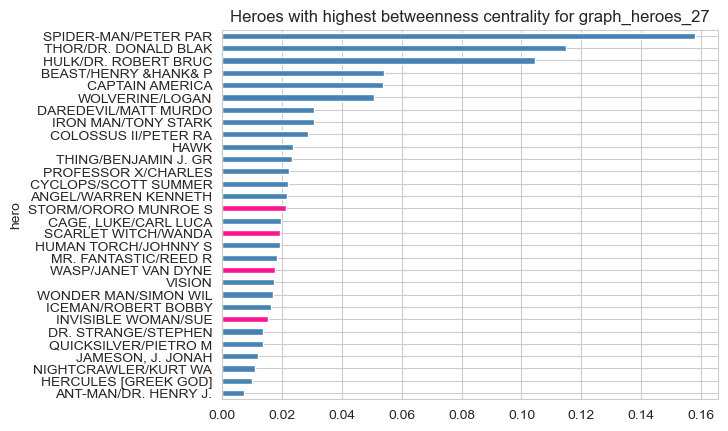

In [160]:
plot_betweenness_centralities(graph_heroes_27, 'Heroes with highest betweenness centrality for graph_heroes_27', 30)

As we can see, if we use the network with at least 27 co-appearances, the betweenness centralities are quite low. This makes sense, as with more available edges the concentration of edges on one person is less likely. We will try the same for the graph_hero_50 network, to see which heroes emerge as best brokers and to see for which network reduction the values are best.

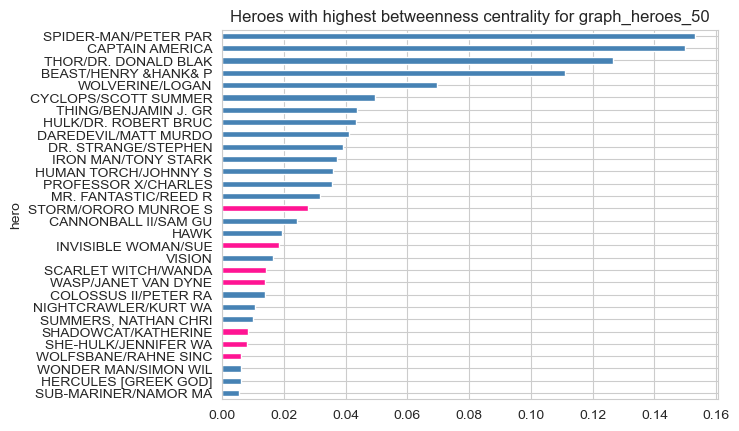

In [161]:
plot_betweenness_centralities(graph_heroes_50, 'Heroes with highest betweenness centrality for graph_heroes_50',30)

It seems like even with a threshold of 50 co-appearances the betweenness centralities are still very low. This indicates that even with reduced edges, there are still many other ways to get to other heroes, or, alternatively, that the edges that are left just don't connect that many heroes anymore.
 Still, we can see that the nodes we saw in the graph are indeed the ones with the highest betweenness centrality: Spider-Man, Thor and Beast are among the top ones. Once again, Captain America is also one of the top heroes, even though from the network it did not seem like he was in a brokerposition. We can also see Thor and DareDevil quite high. If we recall our network graphs, this was expected, as both act as briged between their little group of friends and the rest of the network.

 While we do have women in the toplist, most of them have an almost non existant betweenness centrality, so we cannot claim they are really brokers.

### 4.1.2 which heroes are central in the network?
Here we will expect to see the same people we have been seeing throughout our analysis, but let's see if we can find some surprises:

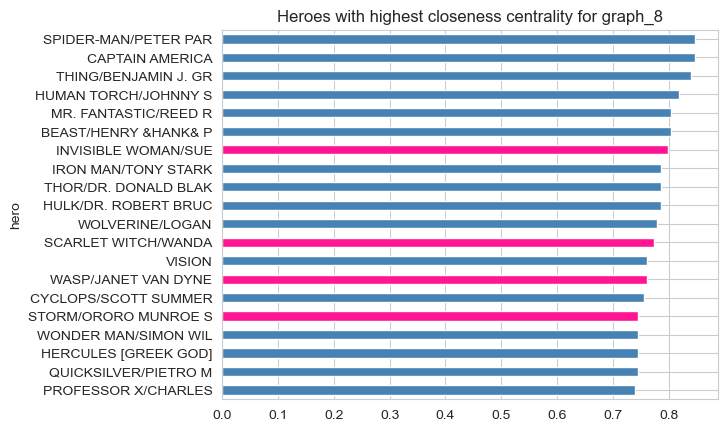

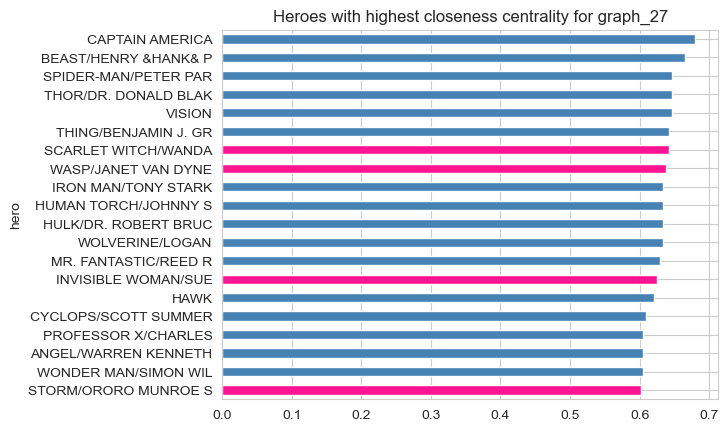

In [162]:
def plot_closeness_centralities(network, title, n):
    closeness_centralities = nx.closeness_centrality(network)
    closeness_centralities_df = pd.DataFrame(list(closeness_centralities.items()), columns=['hero', 'centrality']).set_index('hero')
    colors = ['deeppink' if hero in female_heroes else 'steelblue' for hero in closeness_centralities_df.centrality.nlargest(n).index]
    closeness_centralities_df.centrality.nlargest(n).plot(kind = 'barh', title = title, color = colors)
    plt.gca().invert_yaxis()
    plt.show()

plot_closeness_centralities(graph_heroes_8, 'Heroes with highest closeness centrality for graph_8',20)
plot_closeness_centralities(graph_heroes_27, 'Heroes with highest closeness centrality for graph_27',20)

Yep, as we thought; we are seeing our usual suspects Captain America, Spider-Man and Beast fighting for the top spot in closeness. These heroes are closest to the center of the network, and thus can reach a lot of heroes easily. What's a bit more interesting is the change in positions for the other heroes on the list; some of them seem to switch their position depending on which filtering we use:
- Vision goes from position 13 up to 5 in the graph 27 network, while Mr. Fantastic goes the exact opposite way: from position 5 down to 13. So by removing some edges, we shift the center of the network for at least some of the heroes.

### Conclusion for actor centralities
For both betweenness centrality and closeness centrality, the same names are leading the charts. However, we were able to prove in numbers that heroes that appeared to be in a broker position are indeed among the heroes with the highest betweenness centrality, such as Spider-Man, Thor, DareDevil and Beast.


## 4.2 Group centrality 
Is there a hero group that acts as a connecting node between other groups?
#### 4.2.1 Betweenness centrality
for the group centralities, we will manually define some hero groups as we know them from the Marvel Universe, instead of using the cliques that were found, as these had a huge overlap. We will focus on the 3 hero groups we saw in our network graph: Fantastic Four, Avengers and X-Men. Even though Spider-Man also has a close connection to quite a few people, he is not technically part of a hero squad, and the people surounding him aren't heroes either (such as Aunt May or Mary-Jane).

In [163]:
fantastic_four = ['HUMAN TORCH/JOHNNY S', 'MR. FANTASTIC/REED R', 'INVISIBLE WOMAN/SUE','THING/BENJAMIN J. GR']
avengers = ['CAPTAIN AMERICA', 'IRON MAN/TONY STARK', 'THOR/DR. DONALD BLAK','HULK/DR. ROBERT BRUC','HAWK', 'VISION','WASP/JANET VAN DYNE',
           'ANT-MAN/DR. HENRY J.','BLACK WIDOW/NATASHA', 'SCARLET WITCH/WANDA', 'DR. STRANGE/STEPHEN']
x_men = ['CYCLOPS/SCOTT SUMMER', 'STORM/ORORO MUNROE S', 'PROFESSOR X/CHARLES', 'MARVEL GIRL/JEAN GRE', 'COLOSSUS II/PETER RA', 'NIGHTCRAWLER/KURT WA',
         'ANGEL/WARREN KENNETH', 'ICEMAN/ROBERT BOBBY','QUICKSILVER/PIETRO M', 'SHADOWCAT/KATHERINE', 'BEAST/HENRY &HANK& P', 'WOLVERINE/LOGAN','GAMBIT/REMY LEBEAU','JUBILEE/JUBILATION L','BOOMER/TABITHA SMITH']

hero_groups = {'Fantastic Four': fantastic_four,
               'Avengers': avengers,
               'X-Men': x_men}


In [164]:
for hero_group in hero_groups.keys():
    bc_8 = nx.group_betweenness_centrality(graph_heroes_8, hero_groups.get(hero_group))
    bc_27 = nx.group_betweenness_centrality(graph_heroes_27, hero_groups.get(hero_group))
    print(f'Betweenness centrality for {hero_group}: {round(bc_8,2)} (graph_8), {round(bc_27,2)} (graph_27)')

Betweenness centrality for Fantastic Four: 0.1 (graph_8), 0.08 (graph_27)
Betweenness centrality for Avengers: 0.2 (graph_8), 0.43 (graph_27)
Betweenness centrality for X-Men: 0.11 (graph_8), 0.25 (graph_27)


As we can see, the Avengers are quite a well connected and central group. This is no surprise, given that in the actor centrality we also saw members of this group in the Top10. Additionally, the Avengers are a Hero squad made out of already established heroes, so it is no surprise that each member is well connected by themselves. So anyone who talks to pretty much any member of the avengers to pass on information will have a pretty decent chance they will have met that person.
Additionally, as we saw in our graphs and our actor betweenness centrality, some fringe groups almost exclusively are connected to the rest of the network by a member of the Avengers. This also contributed to a higher score.
Looking at the X-Men, even though they are the largest group by members, their centrality is quite low with 0.11 - 0.25. This indicates that they don't really act as a broker between other groups. Given our network, this too makes sense; the X-Men cluster was concentrated into one area of the network, and it did not look like there were groups that were connected to them rather than the main Avengers cluster.
The Fantastic Four have a very small betweenness centrality by comparison to the other 2 groups, even though they are very central in the network. This is probably due to the fact that they are in the super dense part of the network and there is almost no need to go through a member of Fantastic Four if you can instead pick a member of the Avengers.


### Conclusion for group centralities
From our analysis, we found out that the Avengers group is probably the closest we get to a group that connects other groups. As these heroes are basically all well established superheroes, it makes sense that they all have met various other heroes at some point in their carreer. A bit surprising is the fact that the Fantastic Four do not have a high value, even though they are so close to the center of the network.

# 5 Diffussion

If a hero is attacked by a malicious virus, how will it spread? How high are the probabilities, that it can infect 50 or 100% of the network, and how long will it take?

## 5.1 Selection of diffusion algorithms & network

-   We will use **ICM** (Independent Cascade Model) algorithms for the virus infection simulation in our network. They could efficiently make infection decisions depending on neighboring interactions (transmission probabilities), which is very suitable to our network, as we have various types of neighboring interaction data that can be converted as transmission probabilities. ICM is also computationally straightforward, so that we can observe who has infected whom in which step.

-   Since the diffusion will not work on disconnected components, so we will extract the **largest connected component of our selected graph**. To reach a reliable simulation effect, we will start with the graph_heroes_27. This graph has been used frequently used in clustering part, due to its suitable node size, edge size and network density.

In [165]:
"""
Usage of Chat-GPT: To extracting subgraph with largest connected component: how to extract the largest connected components of a network graph?
"""

# 1. extract the largest connected component for diffusion analysis, as the diffusion will not work on disconnected components

components = list(nx.connected_components(graph_heroes_27))
largest_component = max(components, key=len) 

# 2. subgraph with the largest connected component
graph_27_largest_comp = graph_heroes_27.subgraph(largest_component)

G = graph_27_largest_comp.copy()
n_nodes = G.number_of_nodes()
print(f"The largest connected component with {n_nodes} nodes and {G.number_of_edges()} edges will be used for diffusion analysis.")

# save the largest connected component as a gexf file
path = 'graphs/one_mode_top100_heroes/5_diffusion/'
if not os.path.exists(path):
    os.makedirs(path)
nx.write_gexf(graph_27_largest_comp, path + 'largest_connected_component.gexf')


The largest connected component with 98 nodes and 1011 edges will be used for diffusion analysis.


## 5.2 Calculte transmission probabilities

-   Our calculation of transmission probabilities is based on the edge counts between two nodes and the nodes' degrees
-   Since the diffusion is directed, the transmission probabilites from node A -> B is different than B -> A
-   Calculation details (example: A -> B and B -> A):
    -   get the degree of A and B: degree_A, degree_B
    -   count the edges between A and B (no directed): n_edges
    -   now the transmission probabilities A -> B: n_edges/degree_A
                transmission probabilities B -> A: n_edges/degree_B
        So the two probabilities could be very different: if A's degrees are mostly with other nodes, then A -> B transmission probabilitiy could be very small. Conversely, if B has only connections with A, then A -> B transmission probabilitiy is 1.

-   Our transmission probabilities (A -> B) reflected how significant/important a hero (B) is among another hero (A)'s connections, or how likely another hero (A) is to "interact" or "transmit" something to this hero (B), relative to its other connections. If a hero spends significant time working together with another hero, it makes sense that thar hero will have a higher risk of getting the infection.

-   Finally, to ensure the diffusion works, we scale the probabilities to the same range (0, 1) as the random probabilities by min-max normalization.

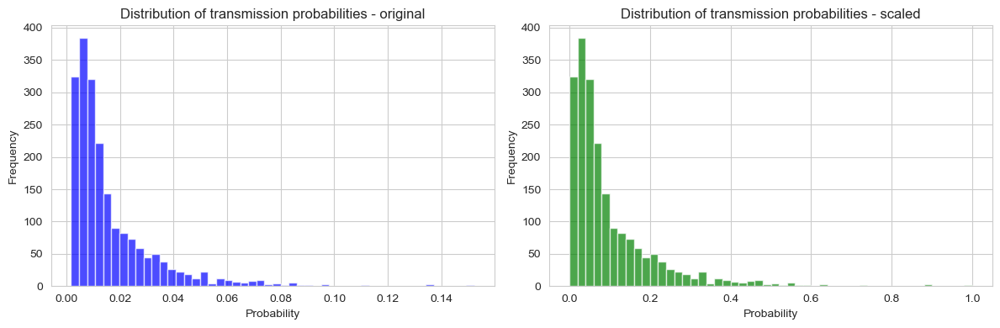

In [166]:
# 2. calculate probabilites of edges by normalizing the count of edge connections from reduced network

# calculate the degree for each hero in top 100 list
top_100_degree = {}
for hero in top_100_heroes:
    degree_hero = network[(network['hero1'] == hero) | (network['hero2'] == hero)]['count_co_appearance'].sum()
    top_100_degree[hero] = degree_hero

def calculate_trans_prob(G):
    # Initialize a dictionary to store the probabilities for each edge
    trans_prob = {}
    
    # Iterate over all (unique) edges in the graph
    for u, v in G.edges():
        # Get the degree of the nodes u and v
        degree_u = top_100_degree[u]
        degree_v = top_100_degree[v]
        
        # Count the edges between node u and node v (no directions)
        edge_count_uv_vu = network_top_100[((network_top_100['hero1']==u) & (network_top_100['hero2']==v)) | ((network_top_100['hero1']==v) & (network_top_100['hero2']==u))]['count_co_appearance'].values[0]
        
        # Calculate the transmission probabilities for the edge (u, v) and edge (v, u)
        p_uv = edge_count_uv_vu / degree_u  # Probability from u to v
        p_vu = edge_count_uv_vu / degree_v  # Probability from v to u
        
        # Store the probabilities for both directions of the edge
        trans_prob[(u, v)] = p_uv
        trans_prob[(v, u)] = p_vu

    trans_prob = sorted(trans_prob.items(), key=lambda x: x[1], reverse=True)
    return trans_prob

trans_prob = calculate_trans_prob(G)

# scale trans_prob by max min normalization
max_trans_prob = max(trans_prob, key = lambda x: x[1])[1]
min_trans_prob = min(trans_prob, key = lambda x: x[1])[1]
trans_prob_scaled = [(edge, (prob - min_trans_prob) / (max_trans_prob - min_trans_prob)) for edge, prob in trans_prob]

# distribution of the edge probabilities
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 4))

axes[0].hist([prob for edge, prob in trans_prob], bins=50, color='blue', alpha=0.7)
axes[0].set_title('Distribution of transmission probabilities - original')
axes[0].set_xlabel('Probability')
axes[0].set_ylabel('Frequency')

axes[1].hist([prob for edge, prob in trans_prob_scaled], bins=50, color='green', alpha=0.7)
axes[1].set_title('Distribution of transmission probabilities - scaled')
axes[1].set_xlabel('Probability')
axes[1].set_ylabel('Frequency')

plt.tight_layout() 
plt.show()

-   The upper two plot are the distribution of transmission probabilities before (left) and after (right) normalization. 
-   The two plots have the same distribution, however, the values ranges are quite different. around 0 - 0.15 before scaling and 0 - 1 after.
-   The scaling is essential, it matches the range of random probabilities typically used in possibility spaces of ICM. This ensures that the transmission probabilities are compatible with the ICM spaces, enable the simulation work.

## 5.3 ICM (Independent Cascade Model) algorithm
-   Start with one seed hero as infected, all other heroes in the network as not infected.
-   For each step, we search through all the direct connected neighbors of the newly infected heroes in the last step. For each neighbor, we compare the transmission probability with random probability, if transmission probability > random probability, then this hero is infected. 
-   Repeat until there are no newly infected heroes in the step, then stop this simulation.

In [167]:
"""
Usage of Chat-GPT: To generate 
-   initialize_infection function
-   around 10% of the icm_simulation function (mainly debugging, and generating arrows, colors in drawing network)
"""
def initialize_infection(G, seed_nodes):
    # Initially set all as False (not infected)
    infection_status = {node: False for node in G.nodes()} 
    
    # Infect the seed nodes
    for node in seed_nodes:
        infection_status[node] = True
    return infection_status



def icm_simulation(G, random_seed_value, infection_status, transmission_probs, plot_graph=True,with_labels=False, save_graph = False):
   
    global seed_node, nodes_infected, edges_infected, n_step

    # Initialize a dictionary to store the newly infected nodes at each time step
    nodes_infected_new, edges_infected_new = [], []
    nodes_infected_before = [node for node, value in infection_status.items() if value]
    num_infected_before = sum(infection_status.values())

    random.seed(random_seed_value)
    # Iterate over all nodes
    for node in G.nodes():
    
        # If the current node is infected
        if infection_status[node]:
            # Iterate over the neighbors of the current node
            for neighbor in G.neighbors(node):
           
                # If the neighbor is susceptible and has not been infected yet
                if not infection_status[neighbor]:
                    # Determine if the infection spreads to the neighbor based on transmission probability
                    transmission_prob = next((value for edge, value in transmission_probs if edge == (node, neighbor)), None)
                    if random.random() < transmission_prob:
                      
                        nodes_infected_new.append(neighbor)
                        nodes_infected.append(neighbor)
                        edges_infected_new.append((node,neighbor))
                        edges_infected.append((node,neighbor))    

    # Update the infection status of newly infected nodes
    for node in G.nodes():
        if node in nodes_infected_new:
            infection_status[node] = True
    
    num_infected_after = sum(infection_status.values())
    num_infected_new = num_infected_after - num_infected_before
    edges_not_infected = [edge for edge in G.edges() if edge not in edges_infected]

    # plot the network
    if plot_graph and num_infected_new > 0:
        plt.figure(figsize=(16, 8))
        pos = nx.kamada_kawai_layout(G)

        # Define node colors based on their infection status
        node_color_map = ['blue' if node in seed_node else 'red' if node in nodes_infected_new else 'orange' if node in nodes_infected_before else 'lightgray' for node in G.nodes()]

        nx.draw_networkx_nodes(G, pos, node_color=node_color_map, node_size=50)
        nx.draw_networkx_edges(G, pos, edgelist=edges_not_infected, edge_color='lightgray')
        nx.draw_networkx_edges(G, pos, edgelist=edges_infected, edge_color='orange', arrows=True, arrowstyle="->", arrowsize=10, connectionstyle='arc3, rad=0.1')

        if with_labels:
            nx.draw_networkx_labels(G, pos, labels={node: node for node in nodes_infected_new}, font_size=8)
        plt.title(f"Step {n_step} (initial node: {seed_node[0]}): {num_infected_new} newly infected heroes (red), {G.number_of_nodes() - sum(infection_status.values())} not infected heroes ")
        plt.show()

    if save_graph:
        nodes_lst = seed_node + nodes_infected_new + nodes_infected_before
        infected_graph = G.subgraph(nodes_lst)
        infected_graph = infected_graph.edge_subgraph(edges_infected)
    
        nx.write_gexf(infected_graph, path + f'icm_simulation_step_{n_step}.gexf')

    return infection_status, num_infected_new 


## 5.4 ICM simulations with all possible seed heroes and replications

-   We iterate over all heroes in the network as initial seed hero and simulate the spread of the infection. With different initial heroes, we use a fixed random seed to generate random probabilities to ensure exploring the same possibility space with different initial heroes.
-   To reach a more reliable result, we repeat the upper process 50 times, which means 50 different possibility space for ICM algorithms, each with a different random seed. As some random seed may generate a possibility space with relatively higher values, which will lead to a weaker spread, while some random seed generate lower values possibility space and lead to a wider spread.



In [168]:
df_no_repeat = pd.DataFrame(columns=['seed_node', 'n_step', 'n_nodes_infected', 'n_edges_infected','random_seed']) # to store how many steps are needed with a given seed node

# for generating 50 different possibility spaces
random.seed(120)
random_seeds = [random.randint(1, 1000000) for _ in range(50)] # ensure the seeds have large difference -> large differences of possibility space

# iterate over each possibility spaces (random seed) 
for random_seed in random_seeds:

    # iterate over all nodes in the network as initial seed node
    for node in set(G.nodes): 
        seed_node = [node]
        edges_infected, nodes_infected = [], []
        infection_status = initialize_infection(G, seed_node)
        n_step = 0
        num_infected_new = 1
        while num_infected_new > 0:
            n_step += 1
            infection_status, num_infected_new = icm_simulation(G, random_seed,infection_status, trans_prob_scaled, False, save_graph = False)

        new_row = pd.DataFrame([[node,n_step-1,sum(infection_status.values()),len(list(set(edges_infected))),random_seed]], columns=['seed_node', 'n_step', 'n_nodes_infected', 'n_edges_infected','random_seed'])
        df_no_repeat = pd.concat([df_no_repeat, new_row])

df_no_repeat = df_no_repeat.sort_values(by = ['n_nodes_infected', 'n_step','n_edges_infected'], ascending=[False, True, True]).reset_index(drop=True)
for column in ['n_step', 'n_nodes_infected', 'n_edges_infected','random_seed']:
    df_no_repeat[column] = pd.to_numeric(df_no_repeat[column], errors='coerce')
df_no_repeat

,seed_node,n_step,n_nodes_infected,n_edges_infected,random_seed
0,SHE-HULK/JENNIFER WA,11,98,123,197812
1,BLACK WIDOW/NATASHA,11,98,128,197812
2,FALCON/SAM WILSON,12,98,119,197812
3,QUASAR III/WENDELL V,12,98,124,197812
4,SCARLET WITCH/WANDA,12,98,125,197812
...,...,...,...,...,...
4895,BLACK KNIGHT V/DANE,0,1,0,4528
4896,USAGENT/CAPTAIN JOHN,0,1,0,4528
4897,"HUDSON, HEATHER",0,1,0,909229
4898,"CAGE, LUKE/CARL LUCA",0,1,0,909229


With a quick view, we can see that the five most efficient infection simulations have the same random seed. This means that the random seed 197812 is likely to generate a possibility space with small random probabilities, which made infection easier to spread for all initial seed heroes. And the random seed 909229 is likely to generate a possibility space with large random probabilities, which made the infection harder to spread. This ensures the comparison between different initial heroes more accurate.

## 5.5 How high is the probability that the heroes in whole network are infected? And how high is the probability that more than 50% of the network get infected?

In [169]:
# In the total 4900 simulations, how many times are all heroes infected?
n_simulation = df_no_repeat[df_no_repeat['n_nodes_infected'] >= n_nodes].shape[0]
prob_all_infected = n_simulation/(df_no_repeat.shape[0])
print("If a hero is attacked by a malicious virus, there is")
print(f"{prob_all_infected*100:.2f}% probability that all heroes in the network are infected")

# how many times are over 50% of heroes infected?
n_simulation = df_no_repeat[df_no_repeat['n_nodes_infected'] >= n_nodes/2].shape[0]
prob_half_infected = n_simulation/(df_no_repeat.shape[0])
print(f"{prob_half_infected*100:.2f}% probability that more than 50% of heroes in the network are infected")

If a hero is attacked by a malicious virus, there is
1.06% probability that all heroes in the network are infected
84.12% probability that more than 50% of heroes in the network are infected


Through our 4900 simulations, it seems the chance is quite small (1.06%) to infect all heroes in the network. But the virus could spread very efficient (84.12%) to infect half of the network. Let's have a more detailed check of probabilities distribution.

## 5.6 How does probability distribution look like to infect the network across percentage of hero population?

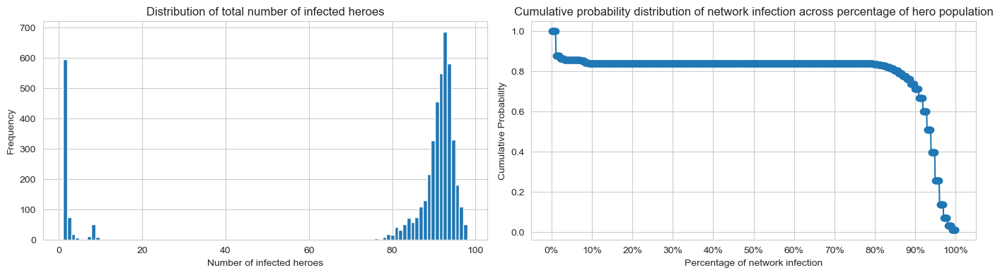

In [170]:
"""
Usage of Chat-GPT: To generate plots
"""
def plots_infection_distribution(df,title1,title2):
    thresholds_lst = np.linspace(0, 1, 1001)
    prob_infection = []
    for thres in thresholds_lst:
        # how many simulations that with infected heroes >= threshold
        n_simulation = df[df['n_nodes_infected'] >= thres*n_nodes].shape[0]
        prob_infection.append(n_simulation/(df.shape[0]))


    fig, axs = plt.subplots(1, 2, figsize=(14, 4))  
    axs[0].hist(df['n_nodes_infected'], bins=100)
    axs[0].set_title(title1)
    axs[0].set_xlabel('Number of infected heroes')
    axs[0].set_ylabel('Frequency')
    axs[0].grid(True)

    axs[1].plot(thresholds_lst, prob_infection, marker='o', linestyle='-')
    tick_positions = np.linspace(0, 1, 11)
    tick_labels = [str(int(i*100))+"%" for i in np.linspace(0, 1, 11)]
    axs[1].set_xticks(tick_positions)
    axs[1].set_xticklabels(tick_labels)
    # axs[1].set_xlim(1, 0) # reverse x-axis
    axs[1].set_title(title2)
    axs[1].set_xlabel('Percentage of network infection')
    axs[1].set_ylabel('Cumulative Probability')
    axs[1].grid(True)

    plt.tight_layout()  
    plt.show()

title1 = 'Distribution of total number of infected heroes'
title2 = 'Cumulative probability distribution of network infection across percentage of hero population'
plots_infection_distribution(df_no_repeat,title1,title2)

The two plots are based on 4900 ICM simulations of our network with 98 heroes.
The **left plot** reflects distribution of how many heroes are infected in each simulation. We could see that it is a bimodal distribution, where most of the simulations could infect between 80 - 98 heroes, while a lot of simulations stop at the first step.
  - Hard start phase: The low value peak at 1 suggests that many simulations stop infection spreading at the early stage (mostly at first stage). They are very likely the heroes who are isolated, with very few interactions with other heroes, and are positioned at a quiet corner of network. The chance is very high that all transmission probabilities are smaller than random probabilities. This leads early stop of the simulation.
  - Fast spreading phase: Between the two clusters (10 - 75 infected heroes) there are almost no frequencies. This suggests that, once 10 heroes are infected, it is very unlikely that the simulation will stop. This is because 10 heroes could have a large amount of yet not infected neighbors, the chance will be very small that all transmission probabilities are smaller than random probabilities. And even if a hero is not infected by one hero, he/she could be later be infected by other heroes.
  - End phase: The high value peak at around 92 suggests that most of the simulations could infect over 80% of the heroes in the network. However, there are only around 50 simulations could infect the entire network. This means that there are always a few heroes not infected in most of the simulations. We assume that these are again more isolated loners, that don't interact as much with other heroes. Additionally, there are subgroups that interact with the rest of the network soley by one hero (Spider-Mans network and Asgardians as an example). If that hero dodges the infection, the subgroups remain uninfected.


Let's view the distributions from another aspect.
The **right plot** reflects the cumulative probability to infect the network with a certain percentage threshold. 
  - the X-Axis indicates the infection percentage threshold of the network. On the Y-Axis the cumulative probabilities represent the likelihood that the network will be infected with exceed the percentages shown on the x-axis. As an example, the cumulative probability at x-axis 80% is around 0.82, this indicates that the probability that at least 80% of the heroes in the network will be infected is 0.82.
  - 8% -80% network infection (fast spreading phase): The probabilities to infect at least 8% or at least 80% network are same. This indicates that once 8% of the heroes in the network are infected, the majority could not avoid getting infected.
  - 80% - 100% infection: We could see a significant drop on probability, this indicates it is hard to infect the last 10% heroes. 


Overall, the result of simulations suggest if one hero is infected with virus, the network infection will enter three phases:
  - Hard start phase (until 8% network infections): The infection has the best chance to stop in this phase.
  - Fast spreading phase (8% - 80% network infections): In this phase, the virus will spread crazy efficiently. Most of the heroes can not avoid getting infected.
  - End phase (80% - 100% network infections): The spread efficiency will decrease until stop, as most of the heroes are already infected. The rest are the heroes with very few connections. They are the group with high chances to avoid infections due to their low social activity strength.


## 5.7 How long does it take to infect at least 80% (majority) of the heroes in the network?

            n_step  n_nodes_infected  n_edges_infected
count  4104.000000       4104.000000       4104.000000
mean     12.270955         91.619396        119.700049
std       2.398243          3.493718          7.885634
min       7.000000         79.000000         89.000000
25%      11.000000         90.000000        115.000000
50%      12.000000         92.000000        120.000000
75%      14.000000         94.000000        125.000000
max      24.000000         98.000000        146.000000


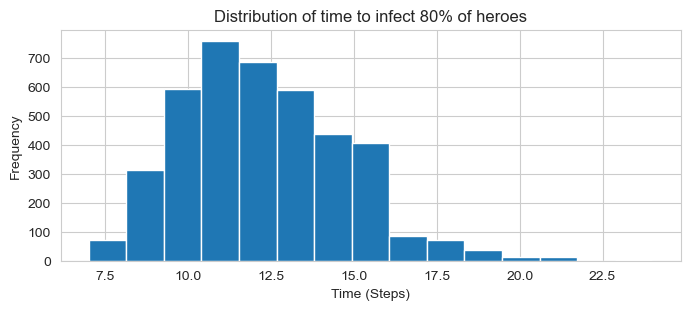

In [171]:
df_filter = df_no_repeat[df_no_repeat['n_nodes_infected'] >= n_nodes*0.8].iloc[:,1:4]
print(df_filter.describe())

# distribution of summary
plt.figure(figsize=(8, 3))
plt.hist(df_filter['n_step'], bins=15)
plt.title('Distribution of time to infect 80% of heroes')
plt.xlabel('Time (Steps)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

The statistics result of 4900 simulations suggest virus spreading in our network could be very quick. If one hero get infected, it takes on average/median 12 steps to infect over 80% of the network. In some cases, it needs only 7 steps. This is likely due to the fact that especially our central heroes work together with other heroes frequently.

## 5.8 How does the most efficient infection path look?

seed_node           SHE-HULK/JENNIFER WA
n_step                                11
n_nodes_infected                      98
n_edges_infected                     123
random_seed                       197812
Name: 0, dtype: object


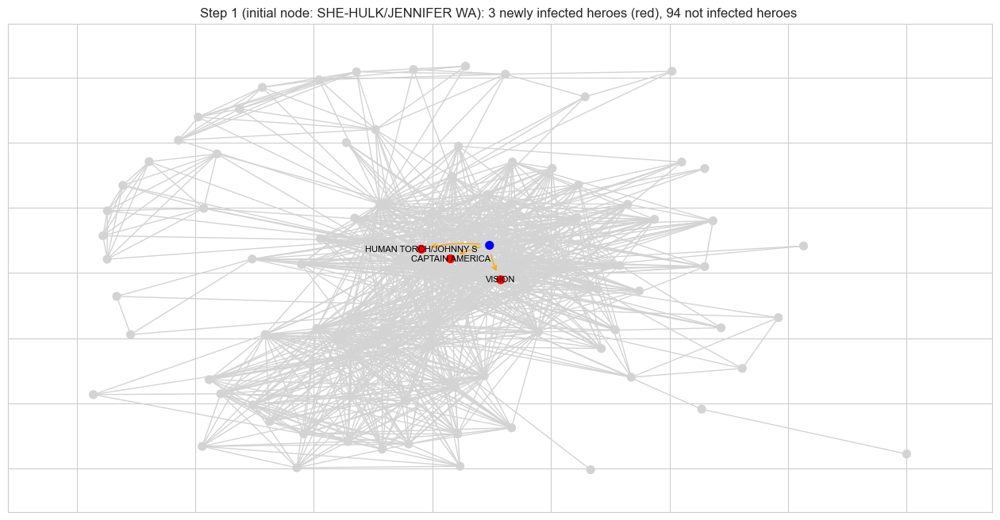

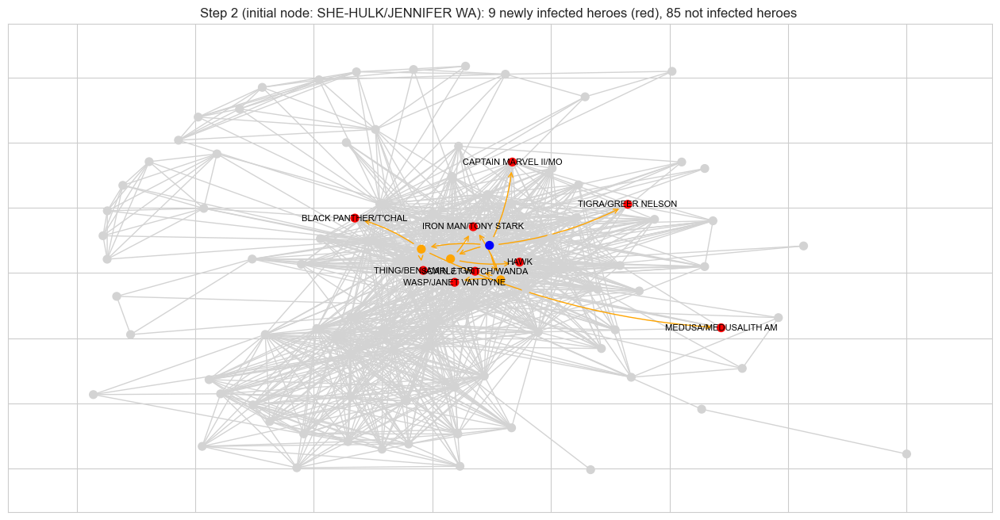

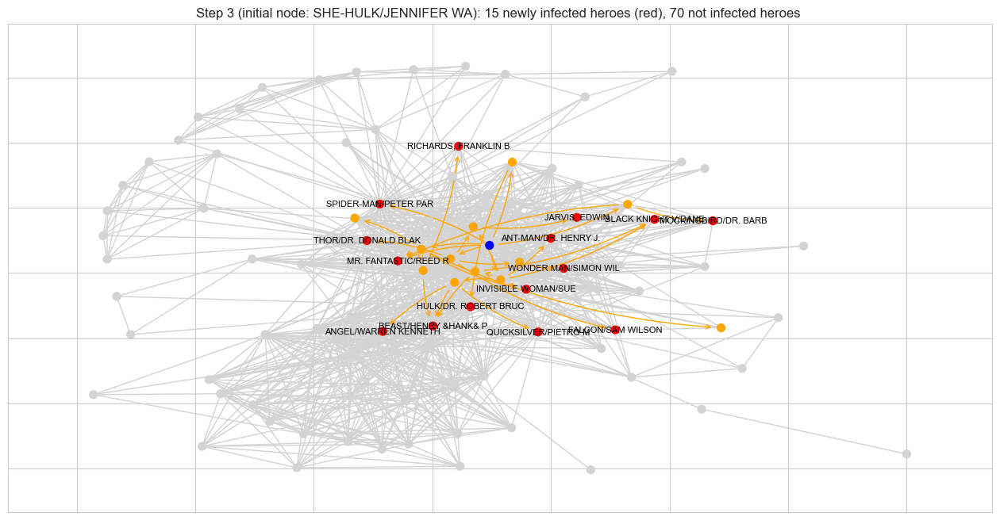

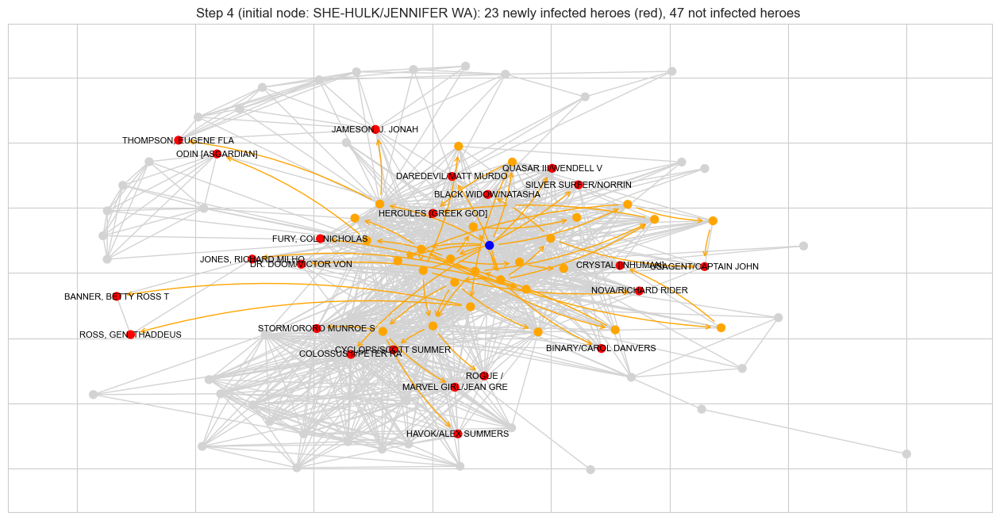

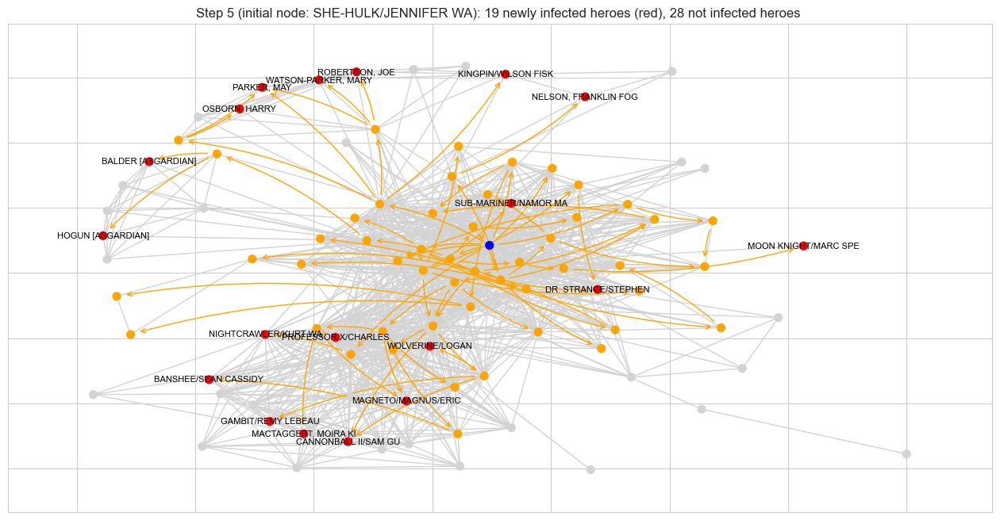

...

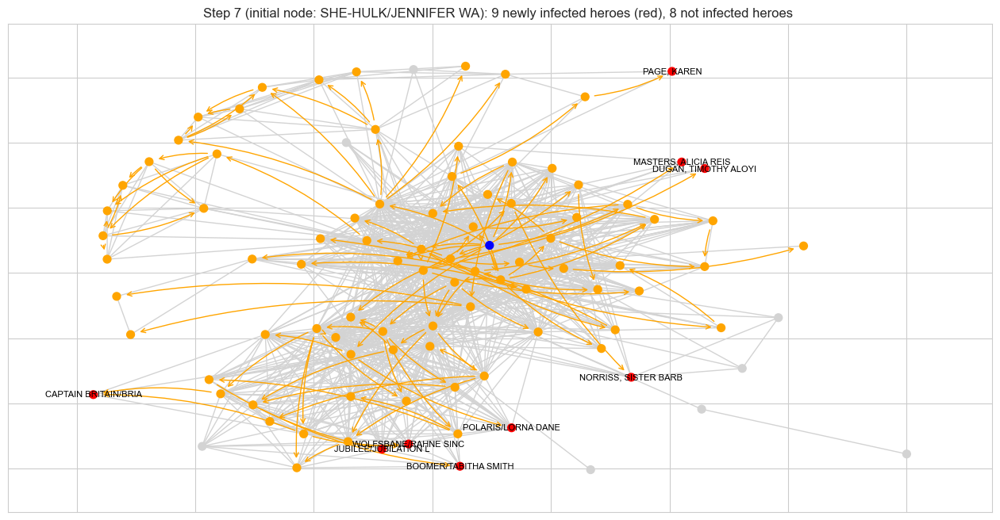

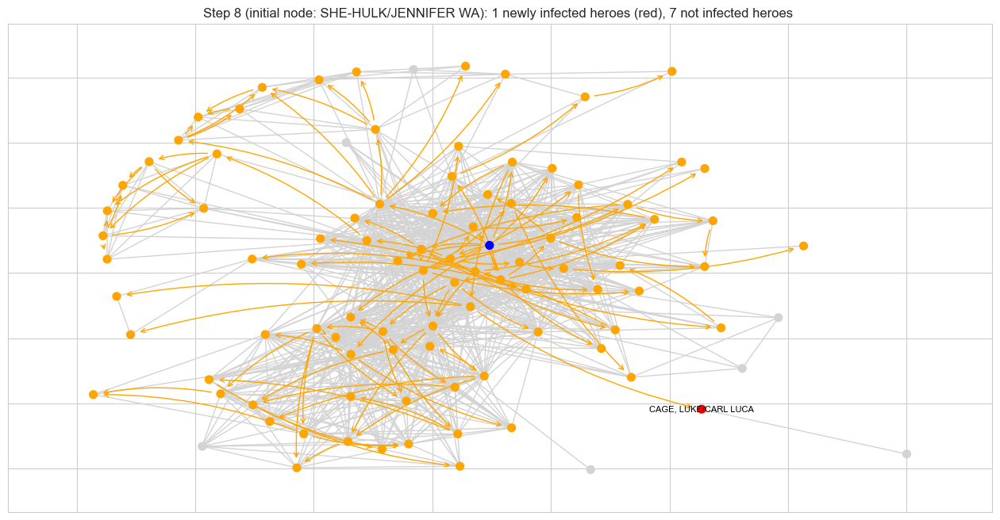

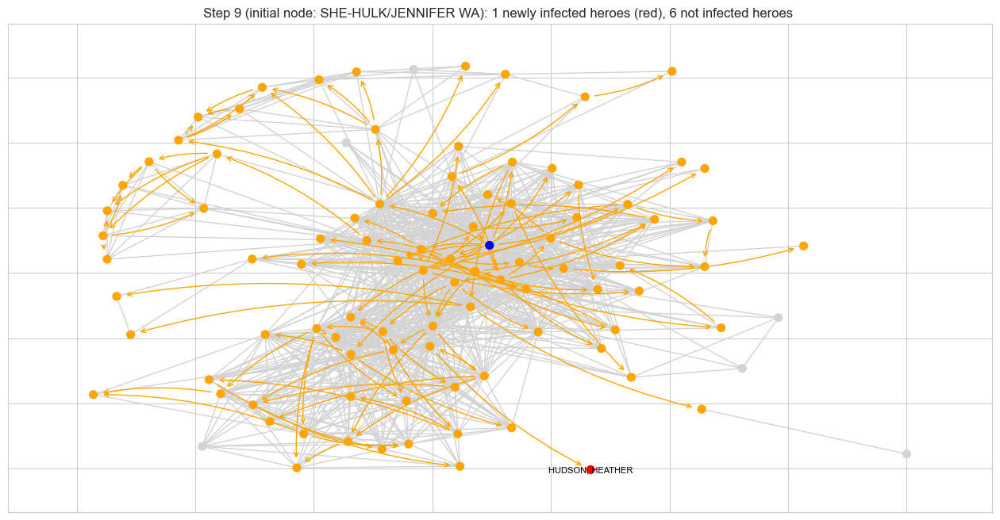

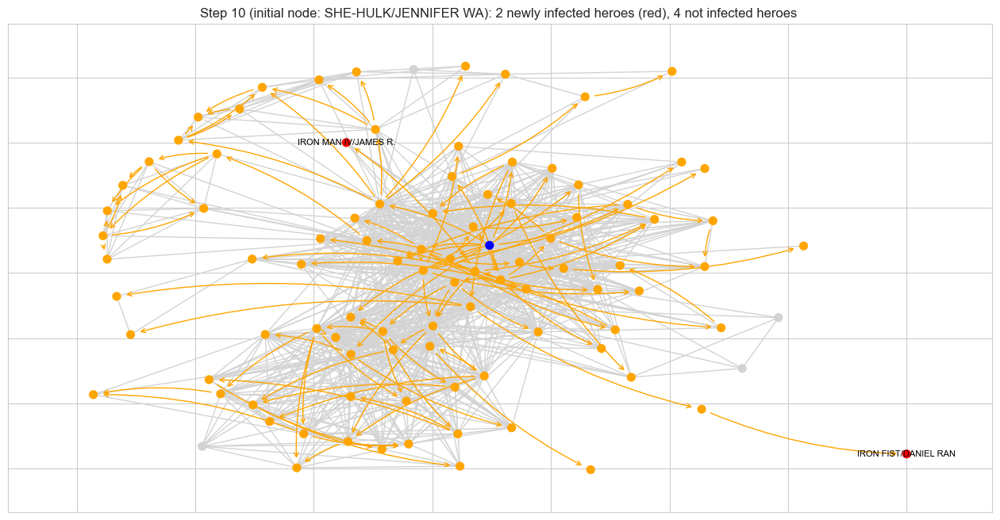

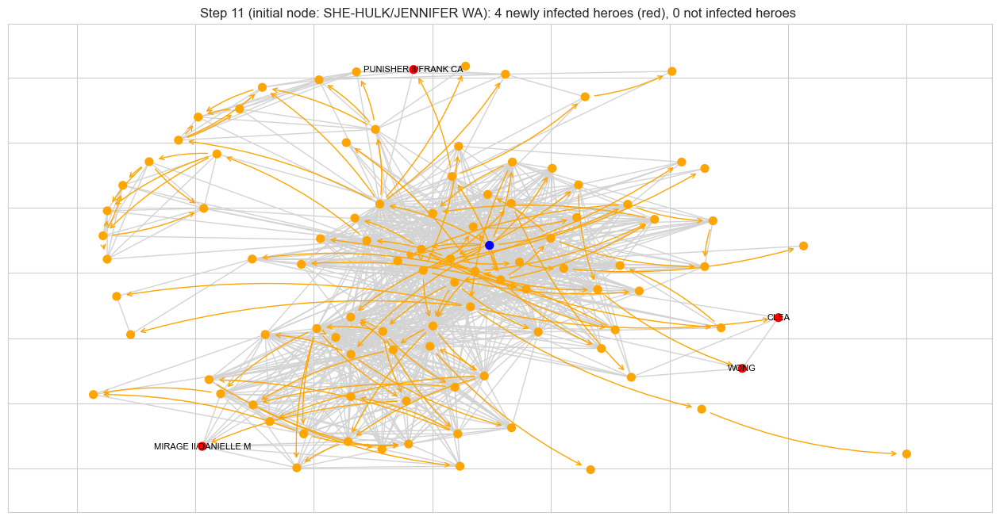

In [172]:
# plot & save the graphs with the most infected & shortest path

print(df_no_repeat.iloc[0,:])
seed_node = [df_no_repeat.iloc[0,0]]
random_seed = df_no_repeat.iloc[0,-1]

# path to save the graphs
path = f'graphs/one_mode_top100_heroes/5_diffusion/icm_simulation/{seed_node[0].replace("/", "_")}_{random_seed}/'
if not os.path.exists(path):
    os.makedirs(path)

nodes_infected, edges_infected = [], []
infection_status = initialize_infection(G, seed_node)
n_step = 0
num_infected_new = 1
while num_infected_new > 0:
    n_step += 1
    infection_status, num_infected_new = icm_simulation(G, random_seed,infection_status, trans_prob_scaled, with_labels = True, save_graph = True)

In this simulation, the starting node was She-Hulk, who is very close to the center of the network. In the first step, she managed to infect some of the heroes with the highest degreecentralities - Captain America being among them.
In step 3, the infection is not super efficient just by numbers: it only infected 15 new heroes, most of them being part of the Avengers cluster, which are generally at high risk due to them all working closely together. However, among those 15 infected are heroes that are crucial to reach fringe groups: Thor, Spider-Man and Beast. These heroes are the brokers for their subgroups, so them being infected is probably a big reason why the infection spread so well.
Once the infection has access to the fringe groups, it spreads like wildfire, as all of the group members are well interconnected.
At step 7, the infection has managed to infect all of Spider-Mans friends and all Asgardians, and is working it's way through the X-Men.
After that is starts to die down, as it has reached almost everyone.

On a sidenote, it is interesting to observe how the infection spread in the Fantastic Four: From Human Torch it spreads to Thing, who spreads it to Mr. Fantastic and Invisible Woman. Given our earlier analysis of potential friendships it is nice to see this confirmed here again: As Human Torch and Mr. Fantastic are less close than they are with Thing, the infection has to pick a path via Thing to reach Mr. Fantastic.

## 5.9 With which initial hero would the virus spread most efficient? With which least efficient?

As we have seen from our probability distribution, sometimes the infection just dies with it's host, because the hero is more of a lone wolf. So we want to analyse a bit more which heros are the best and worst to infect.

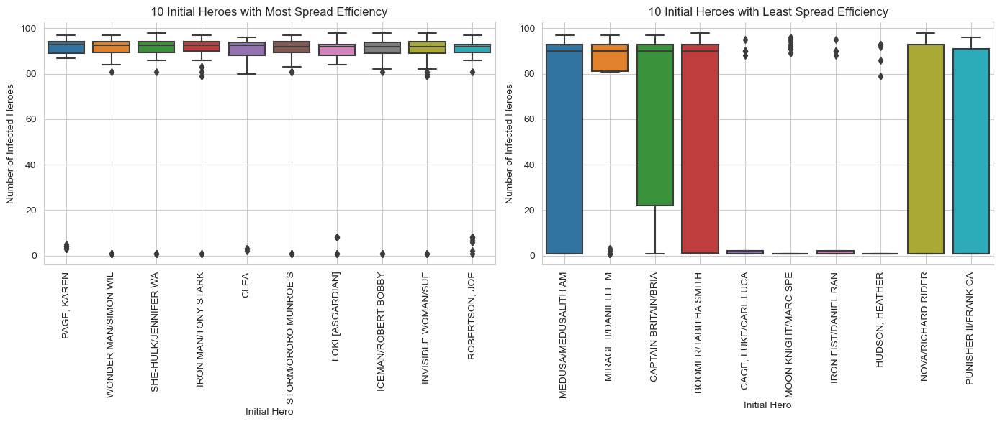

In [173]:
"""
Usage of Chat-GPT: To generate boxplots
-   generate a boxplot, x-axis is categorical column 'A', y-axis is column 'B', sort the boxes by median value from high to low, keep only the highest 10 boxes
"""
# extract the top 10 and tail 10 initial heroes based on medians
medians = df_no_repeat.groupby('seed_node')['n_nodes_infected'].median().sort_values(ascending=False)
top_10 = medians.head(10).index
tail_10 = medians.tail(10).index

df_top10 = df_no_repeat[df_no_repeat['seed_node'].isin(top_10)]
df_tail10 = df_no_repeat[df_no_repeat['seed_node'].isin(tail_10)]

# Sort by median values to ensure the boxplot order matches
df_top10['median_rank'] = df_top10['seed_node'].map(medians)
df_top10 = df_top10.sort_values('median_rank', ascending=False)

df_tail10['median_rank'] = df_tail10['seed_node'].map(medians)
df_tail10 = df_tail10.sort_values('median_rank', ascending=False)
# plot
fig, axs = plt.subplots(1, 2, figsize=(14, 6))
sns.boxplot(x='seed_node', y='n_nodes_infected', data=df_top10, order=top_10, ax=axs[0])
axs[0].set_title('10 Initial Heroes with Most Spread Efficiency')
axs[0].set_xlabel('Initial Hero')
axs[0].set_ylabel('Number of Infected Heroes')
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=90)
axs[0].grid(True)

sns.boxplot(x='seed_node', y='n_nodes_infected', data=df_tail10, order=tail_10, ax=axs[1])
axs[1].set_title('10 Initial Heroes with Least Spread Efficiency')
axs[1].set_xlabel('Initial Hero')
axs[1].set_ylabel('Number of Infected Heroes')
axs[1].set_xticklabels(axs[1].get_xticklabels(), rotation=90)
axs[1].grid(True)

plt.tight_layout()
plt.show()


Looking at the Top10 superspreaders, we don't see names we would expect from our previous network analysis: no Captain America, Spider-Man, Thing or any of the heroes with high centralities or betweenness centrality. However, all values seem to be within the same range. Given the probability distribution of infections, it seems quite likely the top10 contains just some samples of heroes that all have about the same probabilities.
On the other hand, we have the worst spreaders. As we can see, even the bottom 10 have a huge range of successes - 5 of them have either fared very well or very poor, any only 4 of them have consistently been a bad choice to start an infection (or, alternatively, are really good with social distancing). As the boxplots don't reveal too much information, we will instead look at the nodes in our network:


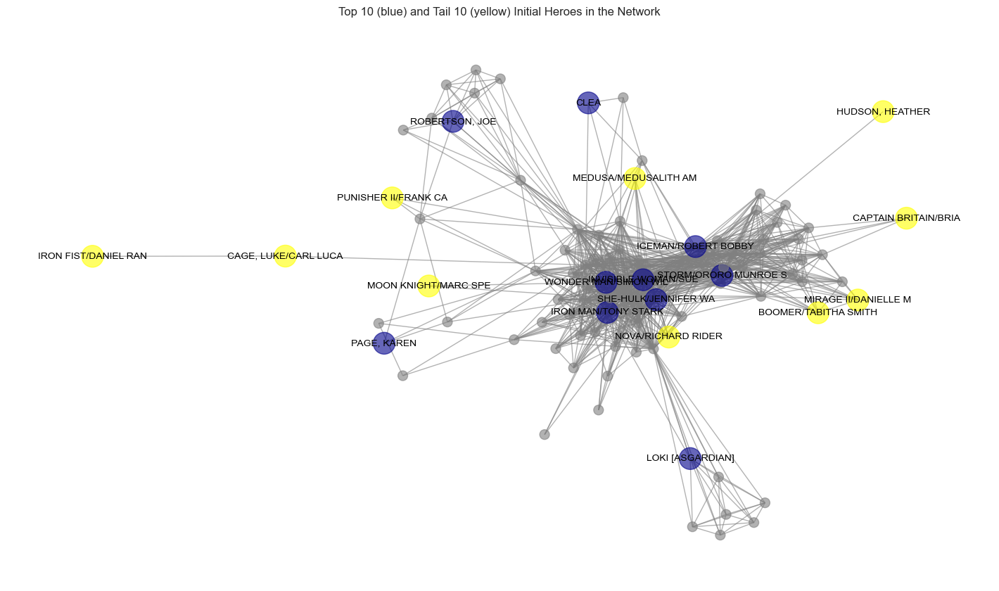

In [174]:
# plot the position of top 10 and tail 10 initial heroes in the network
node_colors = ['darkblue' if node in top_10 else 'yellow' if node in tail_10 else 'gray' for node in G.nodes()]
node_sizes = [500 if node in top_10 or node in tail_10 else 100 for node in G.nodes()]
labels = {node: str(node) for node in G.nodes() if node in top_10 or node in tail_10}

pos = nx.spring_layout(G, seed=42)
plt.figure(figsize=(14, 8))
nx.draw(G, pos=pos, with_labels=False, node_color=node_colors, node_size = node_sizes, font_size=12, alpha=0.6, edge_color='grey')
# draw labels for top 10 and tail 10 nodes
nx.draw_networkx_labels(G, pos, labels, font_size=10)
plt.title('Top 10 (blue) and Tail 10 (yellow) Initial Heroes in the Network')
plt.show()

In the network graph, blue nodes are ten of the most efficient initial heroes, while yellow nodes are ten of the least efficient initial heroes. By observing their positions in the network, we found some factors might positive affect the infection spreading efficiency:
-   Central position or short distance to someone in a central postion. 6 blue nodes locate very central, while none of the yellow nodes position center: they all need more than 2 steps to reach someone in the center cluster.
-   Many neighbors. e.g. some of yellow nodes have only two neighbors: this means that both transmissions must 100% work to ensure further infection spreading.
-   Neighbors with very strong network connections. This increases the chance to quickly end the hard starting phase and enter the fast spreading phase.

So even though in the top10 Captain America was not listed, it is likely he would as well be a good option for spreading the virus, as he very frequently injects himself into other heroes comics.

## 5.10 How would the simulation work when increase the contact frequency?

In our upper simulations, we set the number of contact between two heroes as one. This means if hero A can not infect B by one time, then B can not be infected by A anymore. But in reality, two persons may have contact multiple times, as is indicated by their co-appearances. That's why we would like to extend the upper simulation with extra tolerance, this means, we allow multiple contacts between two heroes.

### 5.10.1 How would the three infection phases change, when repeat the failing step up to five times?

If there are no infections in one step, instead of stopping the simulations, we will repeat this step with another possibility space (meaning different random probabilities) with up to 5 times for each step. 

We would like to see how would the three infection phases in the 5.5 change.

For comparison, we will use the same random seed as upper parts, to ensure the simulations runing with the same 50 possibility spaces.

In [175]:
df_repeat_5 = pd.DataFrame(columns=['seed_node', 'n_step', 'n_repeats', 'n_nodes_infected', 'n_edges_infected','random_seed']) # to store how many steps are needed with a given seed node


# second random seeds list for the repeating steps when no new nodes are infected
random.seed(9874)
random_seeds2 = [random.randint(1, 1000000) for _ in range(50)]

max_repeat = 5

# generate 50 different possibility space. random seeds are same as upper parts.
for random_seed in random_seeds:
    for node in set(G.nodes):
        seed_node = [node]
        edges_infected, nodes_infected = [], []
        infection_status = initialize_infection(G, seed_node)
        n_step, count_repeat, total_repeat = 0, 0, 0
        num_infected_new = 1 # initialize with 1 to enter the while loop
        while sum(infection_status.values()) < G.number_of_nodes():
            n_step += 1
            # for repeating process, use a different random seed to generate different random probabilities
            new_random_seed = random_seed + count_repeat*random_seeds2[count_repeat]
            infection_status_, num_infected_new = icm_simulation(G, new_random_seed,infection_status, trans_prob_scaled, False)

            # if new nodes are infected, update the infection status
            if num_infected_new > 0:
                count_repeat = 0
                infection_status = infection_status_

            # if no new nodes are infected, repeat the process with the same infection status
            elif num_infected_new == 0 and count_repeat < max_repeat:  
                count_repeat += 1
                total_repeat += 1
                infection_status = infection_status
            else:
                break # break the while loop if no new nodes are infected and the process is repeated max_repeat times

        new_row = pd.DataFrame([[node,n_step,total_repeat, sum(infection_status.values()),len(list(set(edges_infected))),random_seed]], columns=['seed_node', 'n_step', 'n_repeats', 'n_nodes_infected', 'n_edges_infected','random_seed'])
        df_repeat_5 = pd.concat([df_repeat_5, new_row])

df_repeat_5 = df_repeat_5.sort_values(by = ['n_nodes_infected', 'n_step'], ascending=[False, True]).reset_index(drop=True)
for column in ['n_step', 'n_repeats', 'n_nodes_infected', 'n_edges_infected','random_seed']:
    df_repeat_5[column] = pd.to_numeric(df_repeat_5[column], errors='coerce')
df_repeat_5

,seed_node,n_step,n_repeats,n_nodes_infected,n_edges_infected,random_seed
0,SHE-HULK/JENNIFER WA,11,0,98,123,197812
1,BLACK WIDOW/NATASHA,11,0,98,128,197812
2,FALCON/SAM WILSON,12,0,98,119,197812
3,QUASAR III/WENDELL V,12,0,98,124,197812
4,SCARLET WITCH/WANDA,12,0,98,125,197812
...,...,...,...,...,...,...
4895,IRON FIST/DANIEL RAN,6,5,1,0,445443
4896,"HUDSON, HEATHER",6,5,1,0,921359
4897,MOON KNIGHT/MARC SPE,6,5,1,0,921359
4898,"HUDSON, HEATHER",6,5,1,0,30973


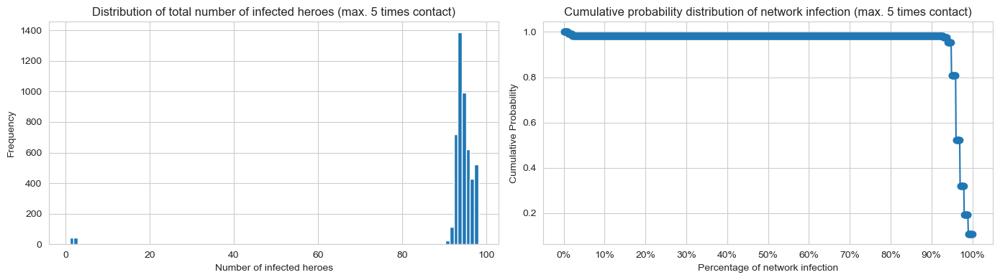

In [176]:
title1 = 'Distribution of total number of infected heroes (max. 5 times contact)'
title2 = 'Cumulative probability distribution of network infection (max. 5 times contact)'
plots_infection_distribution(df_repeat_5,title1,title2)

Comparing to the distribution (without repeatings) at chapter 5.5, we could see a significant increase of infection efficiency:
-   **Hard start phase** is much shorter and less frequent. Only around 50 simulations stop at the earyl phase (around 5 steps). 
-   **Fast spreading phase** starts much earlier and lasts longer. Once 2.5% of the heroes in the network are infected, the spreading will not stop until around 93% of the network isinfected.
-   **End phase** is much shorter, only around 8% of the heroes in the network have the possibility to avoid from the virus infection.

Overall, increasing the contact frequency could significantly increase the virus infections efficiency in a network. If we want to reduce the virus spreading speed in marvel heroes network, decreasing the contact frequency is the most direct and efficient way.

### 5.10.2 Display and analyse the infection path with the most re-contact frequency

seed_node           NOVA/RICHARD RIDER
n_step                              62
n_repeats                           37
n_nodes_infected                    96
n_edges_infected                   117
random_seed                     533524
Name: 0, dtype: object


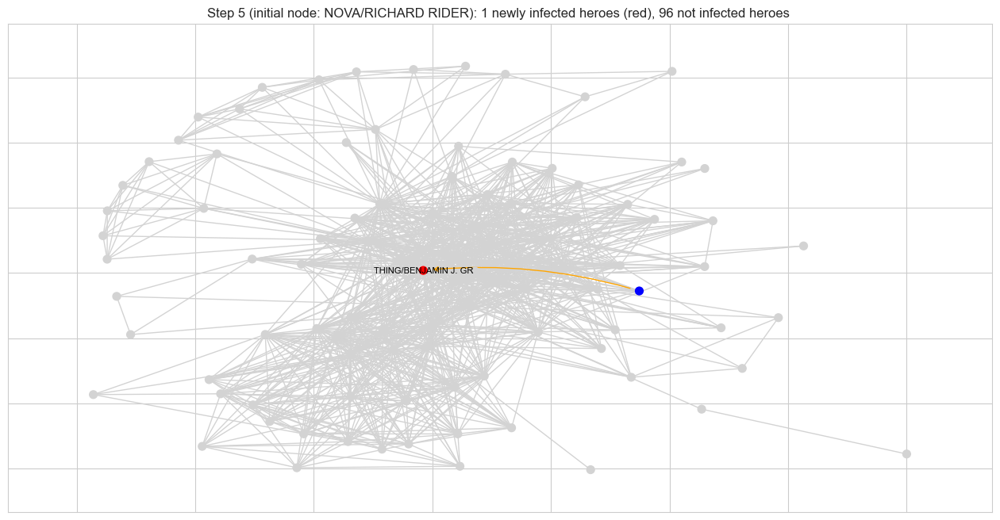

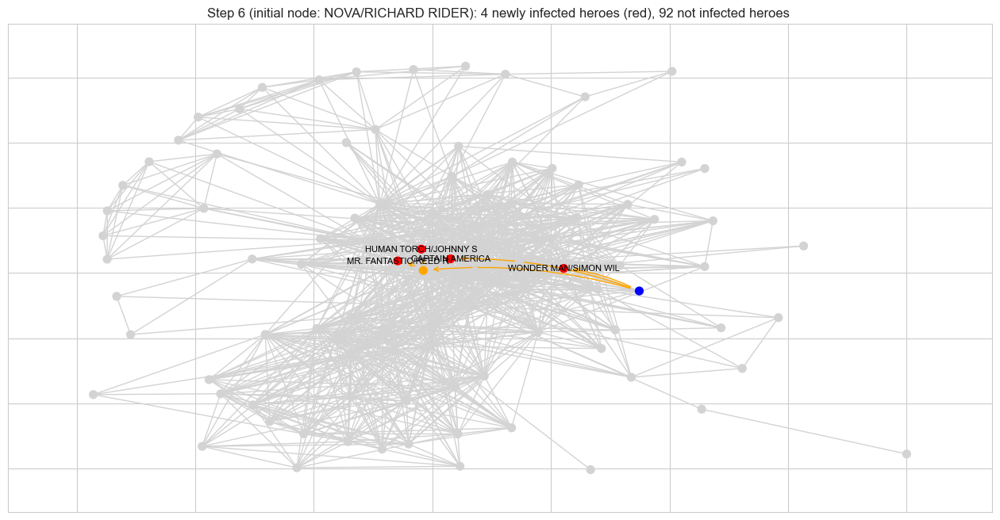

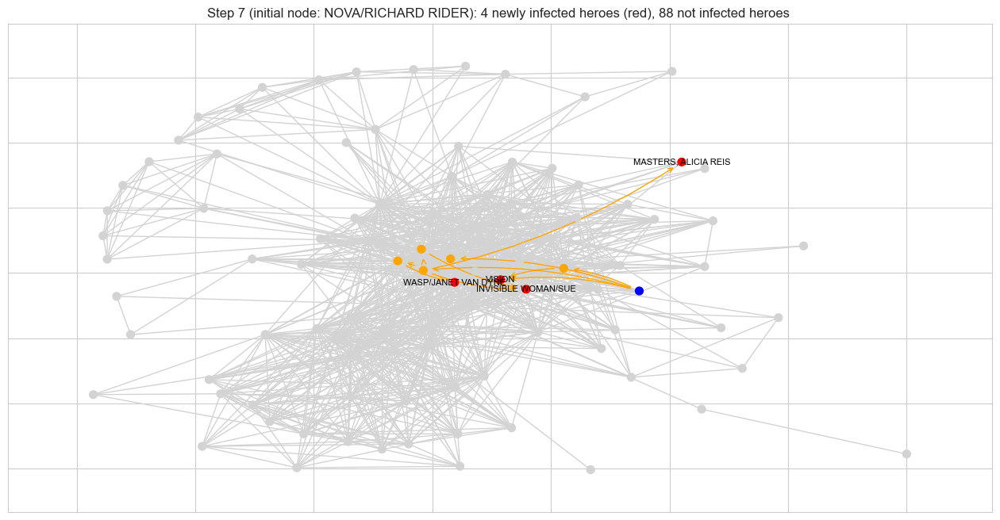

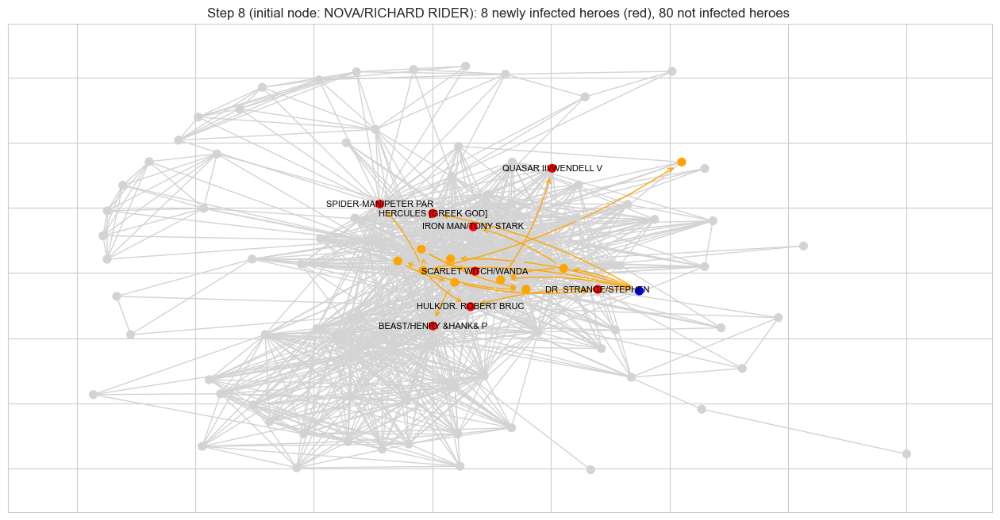

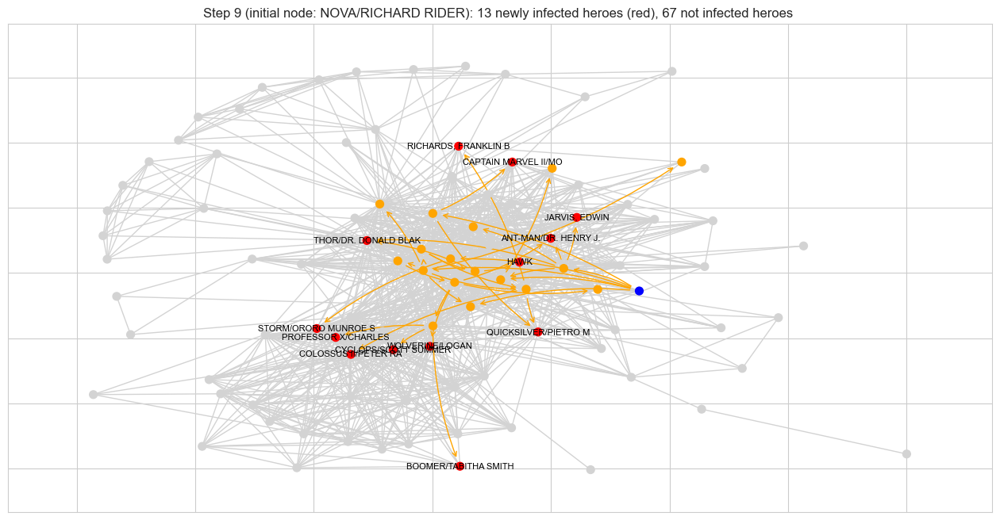

...

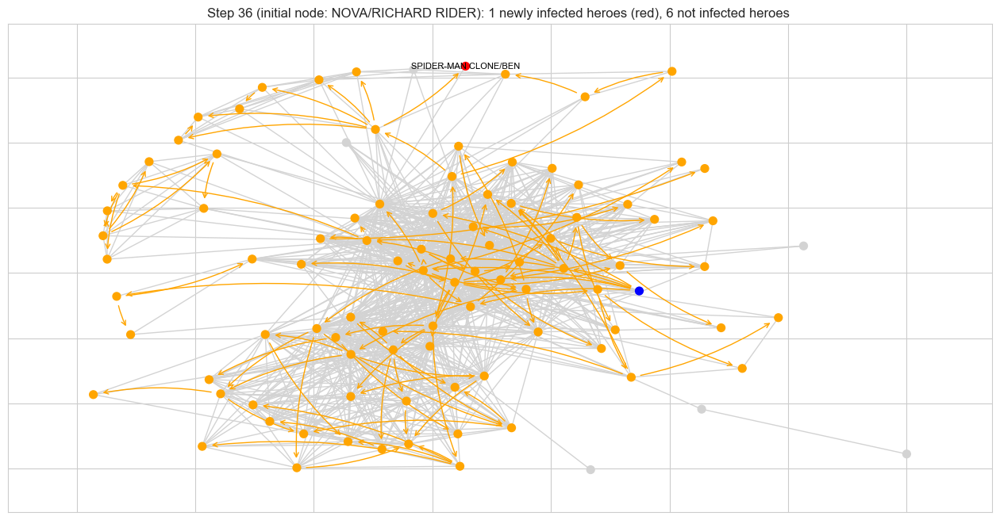

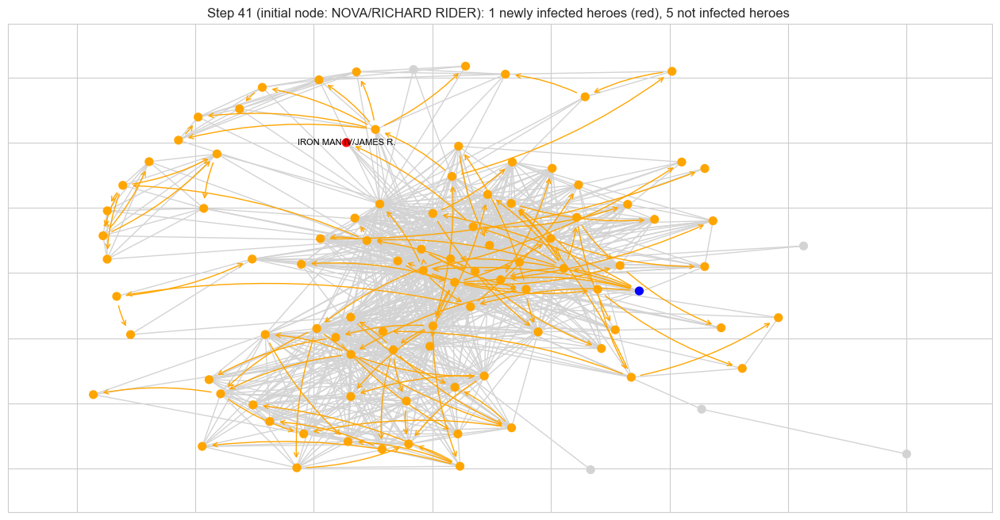

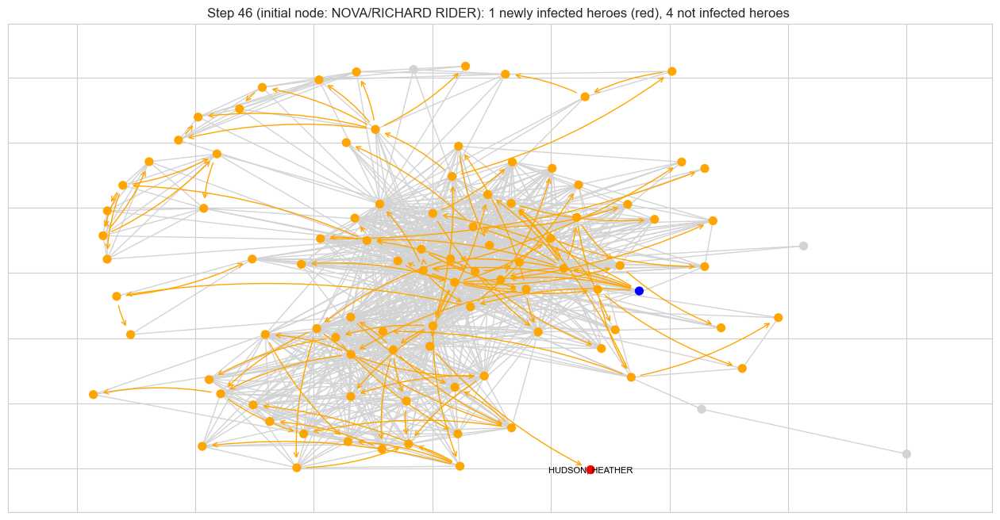

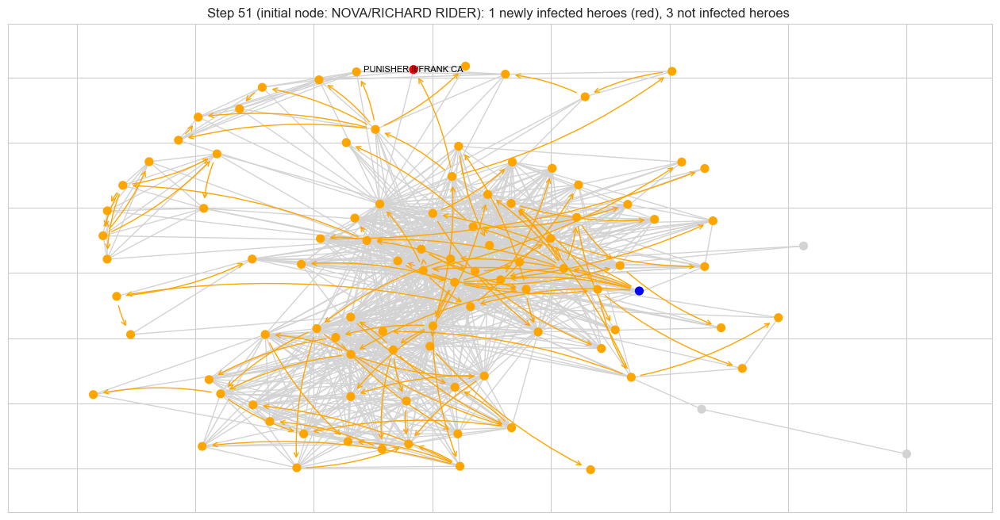

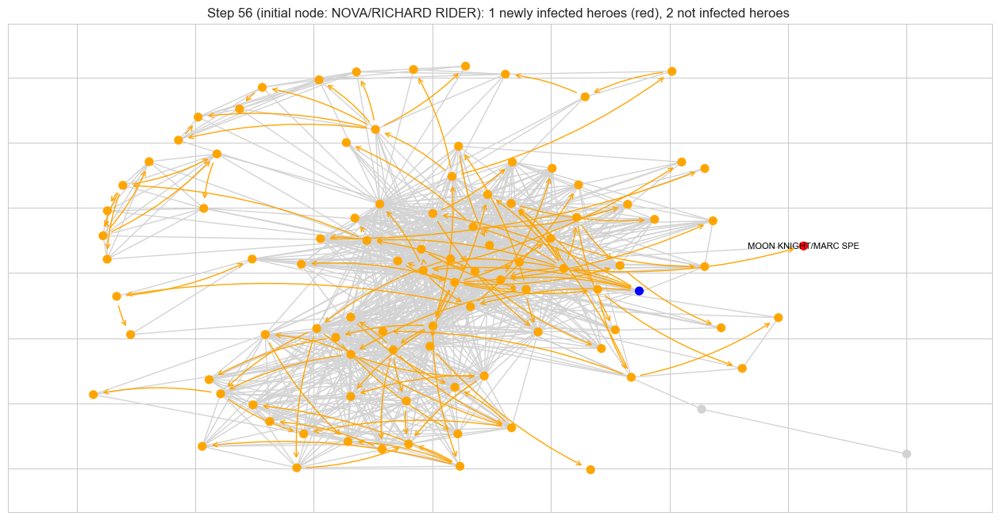

In [177]:
# plot and save the graph with the most repeats
max_repeat = 5
df_repeat_5 = df_repeat_5.sort_values(by = ['n_repeats', 'n_nodes_infected'], ascending=[False, False]).reset_index(drop=True)
print(df_repeat_5.iloc[0,:])
seed_node = [df_repeat_5.iloc[0,0]]
random_seed = df_repeat_5.iloc[0,-1]

path = f'graphs/one_mode_top100_heroes/5_diffusion/icm_simulation_5_contacts/{seed_node[0].replace("/", "_")}_{random_seed}/'
if not os.path.exists(path):
    os.makedirs(path)


edges_infected, nodes_infected = [], []
infection_status = initialize_infection(G, seed_node)
n_step, count_repeat = 0, 0
num_infected_new = 1 # initialize with 1 to enter the while loop
while sum(infection_status.values()) < G.number_of_nodes():
    n_step += 1
    infection_status_, num_infected_new = icm_simulation(G, random_seed + count_repeat*random_seeds2[count_repeat],infection_status, trans_prob_scaled, plot_graph=True, with_labels = True, save_graph = True)

    # if new nodes are infected, update the infection status
    if num_infected_new > 0:
        count_repeat = 0
        infection_status = infection_status_

    # if no new nodes are infected, repeat the process with the same infection status
    elif num_infected_new == 0 and count_repeat < max_repeat:  
        count_repeat += 1
        infection_status = infection_status
    else:
        break # break the while loop if no new nodes are infected and the repeat reached max_repeat times

This infection path has re-contact 37 times, and finally infected 98% of the heroes in the network after 62 steps. 
-   The initial hero "NOVA/RICHARD RIDER" positions at a very side location, meaning low social activity.
-   The first success infection happened at the fifth step, and only infected one person.

This means, if we could reduce the frequency of contact during the time, this infection simulation will stop at the initial phase, without anyone else infected. The 98% infection could be totally avoided. As well as in the later steps, there are many chances to stop the simulation earlier and avoid more heroes get infected by reducing the contact frequency.

## Conclusion

-   Our ICM models simulate the virus infections in the selected network with 50 different possibility spaces. In each space, we used every possible hero as the initial infected node. This delivers a reliable and reproducible result.
-   The transmission speeds and paths of viral infectious diseases are very similar to how it usually happen in real life.
-   In total we have simulated the virus spreading 9800 times with three parameters:
    -   50 different possibility space offer different levels of difficulty (probability) to get infected by contacts.
    -   98 initial heroes indicate it is possible to successfully infect the network at almost any starting point
    -   social contact limits: We have used the limits of 1 and 5 to exam how social contacts influence the virus transmission. Of course, it would be possible to further focus on this parameter to understand what is a suitable social contacts in specific virus active periods.
-   Finally, our model suggests reducing interactions between heroes at the very beginning of the spread of the virus is the most effective way to stop or slow down the spread of the virus, which is also consistent with real-life epidemic prevention measures.

Of course our infection might also be so effective because we are focussing on the top 100 heroes in the Marvel Universe - if we included all 6000 Marvel heroes the infection might have a harder time spreading into every corner of the Marvelverse.

# 6 Hypothesis analysis

## Do well-connected characters appear more frequently in comics?

Hypothesis testing (monadic): We want to check whether the well-connected characters (high node centrality) occur more frequently in comics (node attribute). That is, we suspect that there is a connection between the centrality of characters and the number of their appearances in comics.

- Define the significance level = 0.05
- Calculate the degree centrality of all characters as a vector, and the number of character appearances as a vector.
- Calculate Pearson correlation coefficients between the two vectors. This is the initial reference value of the correlation r.
- Swap the values within the vectors arbitrarily and calculate the correlation. Repeat this permutation and calculate 20,000 times. They are the random correlations.
- Calculate p-value: count how many random correlations are greater than our reference correlation. p-value = count/20000
- If p-value is less than 0.05, then there is a statistically significant correlation between degree centrality and number of appearances. Otherwise, no significant correlation.

6419 heroes will be used in this hypothesis analysis.


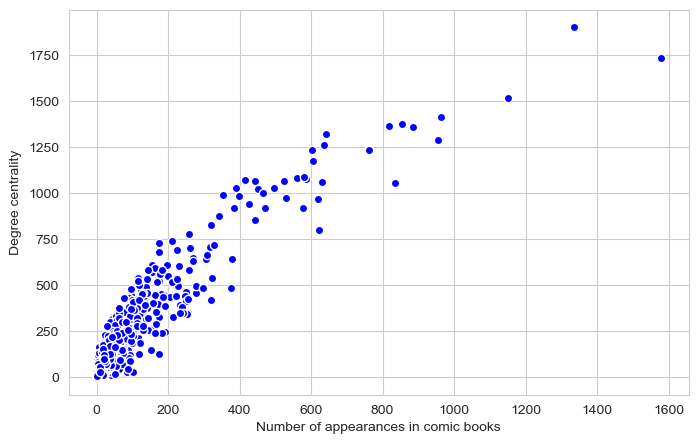

Reference correlation between number of appearance and degree centrality is 0.919.


In [178]:
"""
Usage of Chat-GPT: To generate the scatter plot 
"""

p_alpha = 0.05

hero_lst = edges['hero'].unique()
print(f"{len(hero_lst)} heroes will be used in this hypothesis analysis.")

appearances_lst = [hero_nodes[hero_nodes['hero'] == hero]['count_appearance'].iloc[0] for hero in hero_lst]

degree_centr_lst = [network[(network['hero1'] == hero) | (network['hero2'] == hero)].shape[0] for hero in hero_lst] 

# visualize the scatter plot of two vectors
plt.figure(figsize=(8, 5))
plt.scatter(appearances_lst, degree_centr_lst, color='blue', edgecolors='w')
plt.title('')
plt.xlabel('Number of appearances in comic books')
plt.ylabel('Degree centrality')
plt.show()

# 3. Calculate the reference correlation 
r_reference, _ = pearsonr(appearances_lst, degree_centr_lst)
print(f"Reference correlation between number of appearance and degree centrality is {round(r_reference,3)}.")

From the scatter plot, we could see that the number of appearances in comic books and degree centrality have very clear correlation.

0 random correlations are larger than reference correlation


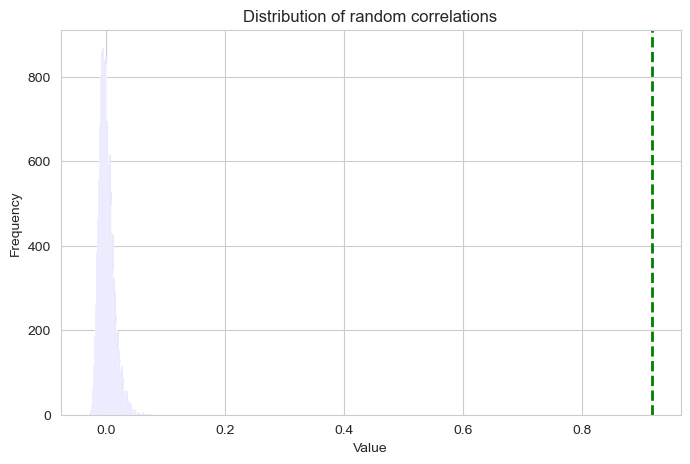

In [179]:
"""
Usage of Chat-GPT: To plot the distribution graph.
"""
# 4. shuffle the two lists and calculate the random correlation, repeat 20,000 times
np.random.seed(0) 
n_permutation = 20000
 
r_random_lst = [] 
count_larger_than_referece = 0 
for _ in range(20000):
    np.random.shuffle(appearances_lst)
    np.random.shuffle(degree_centr_lst)
    r_random, _ = pearsonr(appearances_lst, degree_centr_lst)
    if r_random >= r_reference:
        count_larger_than_referece += 1
    r_random_lst.append(r_random)

print(f"{count_larger_than_referece} random correlations are larger than reference correlation")

plt.figure(figsize=(8, 5))
plt.hist(r_random_lst, bins=100, alpha=0.8, color='blue')
plt.axvline(x=r_reference, color='green', label=f'Reference r = {r_reference}', linestyle='--', linewidth=2)

plt.title('Distribution of random correlations')
plt.xlabel('Value')
plt.ylabel('Frequency')

plt.grid(True)
plt.show()


-   The left blue bars are the distribution of the 20000 random correlations. The correlation values are very small, ranged between -0.05 and 0.1.
-   The green dashed line at the right side (0.9) is the reference correlation between number of appearance and degree centrality.
-   Our reference correlation is significantly larger than all the random correlations.

In [180]:
# calculate the p values

p_value = count_larger_than_referece/n_permutation
print(f"The p value is: {p_value}")

if p_value < p_alpha:
    print("p value is smaller than significance level 0.05")
    print("There is a statistically significant correlation between degree centrality and number of appearances. \nThis means, Well-connected characters appear more frequently in comics.")
else:
    print("p value is greater than significance level 0.05")
    print("There is no statistically significant correlation between degree centrality and number of appearances. \nThis means, Well-connected characters appear not more frequently in comics.")

The p value is: 0.0
p value is smaller than significance level 0.05
There is a statistically significant correlation between degree centrality and number of appearances. 
This means, Well-connected characters appear more frequently in comics.


### Conclusion
Our statistics analysis accepts our hypothesis, and the result aligns as well perfectly to the scatter plot. In the marvel network, well-connected characters (high degree centrality) do appear more frequently in comic series.

# 7 Outlook
We limited out dataset to the top100 heroes, since we did not have a good way of adding the gender for every hero in the network. However, there are dataframes available with more information about heroes, including gender and race. Adding in this dataframe would have enabled us to gain more intricate insights. We did read the dataframe in below just to show what possibilities would be opened up this information were to be added.
We also based our work on the network file that already contained everything for a one-mode-network. Utilizing the nodes and edges files instead, we could have modelled a two-mode-network and then transformed it ourselves. This would most likely result in a slightly different network. We have attempted this below, but did not do any analysis of the resulting network.

Additionally, a two-mode-network might enable us to make a directed network: by distinguishing between main heroes of a series and guests we could potentially model guests – main heroes edges as inbound. This would give us insights into which heroes star mostly in their own vs other series, and would enable us to do a prestige analysis. It is possible that we could have built a directed network with the network file, as – as we saw in the EDA part – that network was not symmetrical. But since we could not confirm that this was the case we did not do it.


In [181]:
# More information about heroes
hero_attributes = pd.read_csv('data/heroes_information.csv', index_col=0)
hero_attributes

,name,Gender,Eye color,Race,Hair color,Height,Publisher,Skin color,Alignment,Weight
0,A-Bomb,Male,yellow,Human,No Hair,203.0,Marvel Comics,-,good,441.0
1,Abe Sapien,Male,blue,Icthyo Sapien,No Hair,191.0,Dark Horse Comics,blue,good,65.0
2,Abin Sur,Male,blue,Ungaran,No Hair,185.0,DC Comics,red,good,90.0
3,Abomination,Male,green,Human / Radiation,No Hair,203.0,Marvel Comics,-,bad,441.0
4,Abraxas,Male,blue,Cosmic Entity,Black,-99.0,Marvel Comics,-,bad,-99.0
...,...,...,...,...,...,...,...,...,...,...
729,Yellowjacket II,Female,blue,Human,Strawberry Blond,165.0,Marvel Comics,-,good,52.0
730,Ymir,Male,white,Frost Giant,No Hair,304.8,Marvel Comics,white,good,-99.0
731,Yoda,Male,brown,Yoda's species,White,66.0,George Lucas,green,good,17.0
732,Zatanna,Female,blue,Human,Black,170.0,DC Comics,-,good,57.0


### Two-mode network example using top 100 heroes and top 200 comic series..

Example using top 100 heroes and top 200 comic series:


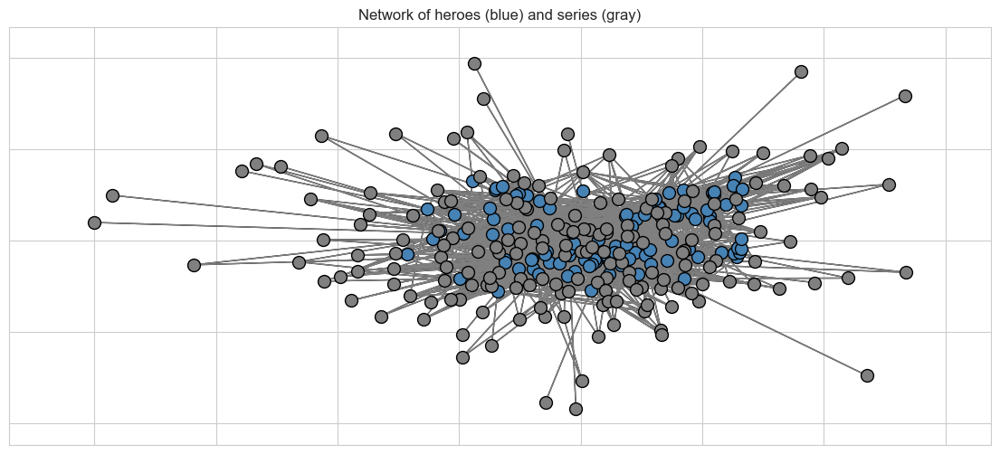

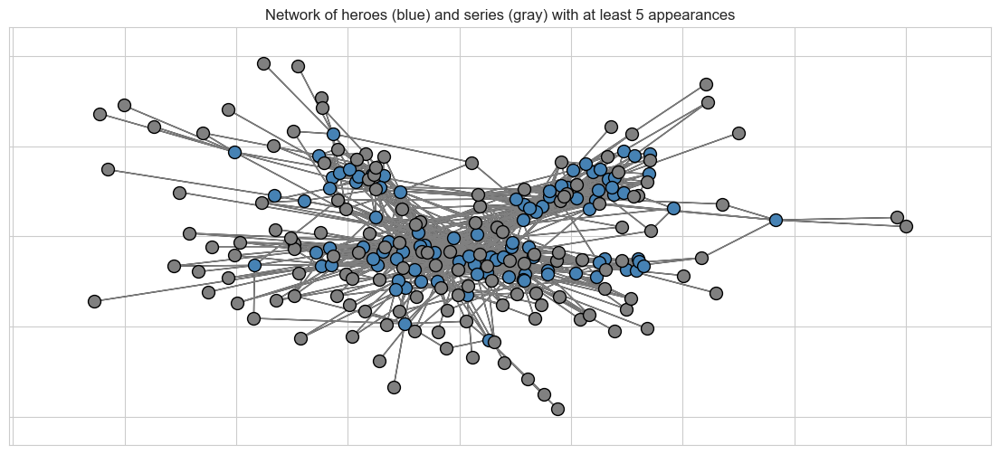

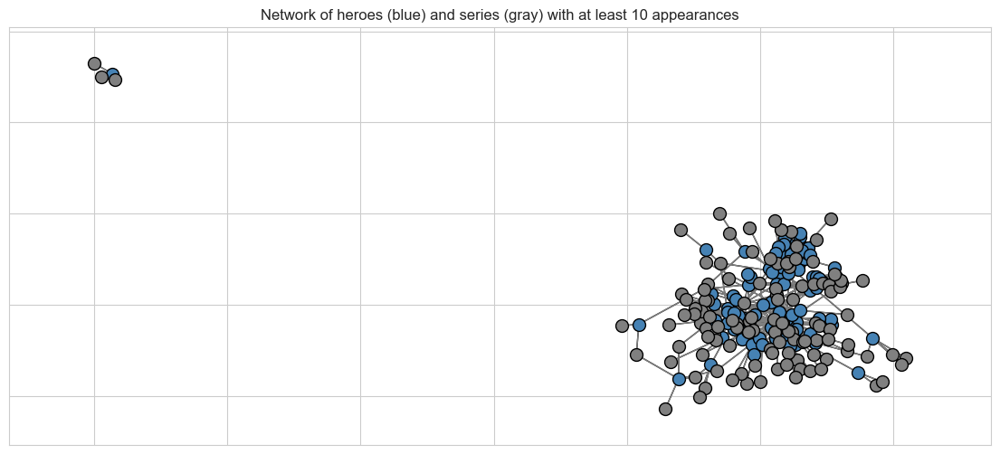

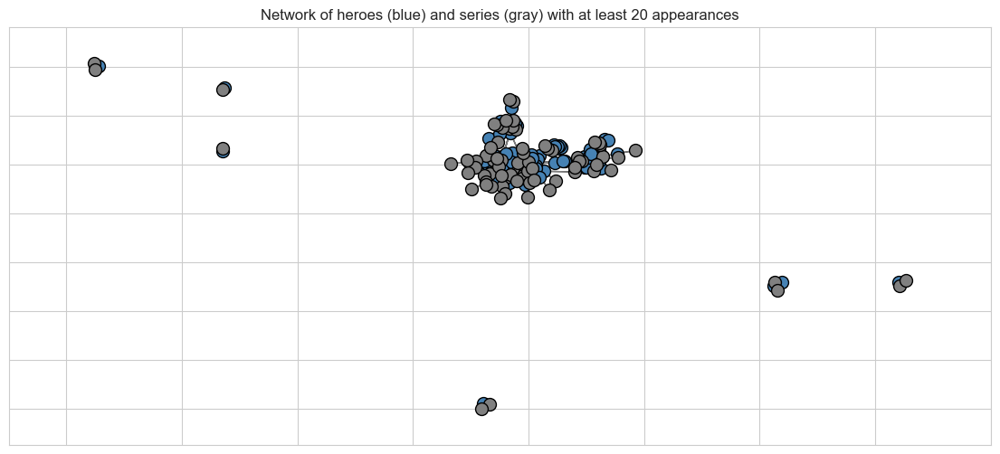

In [182]:
"""
Usage of Chat-GPT: To plot the graph.
"""

def filter_two_mode_network(threshold, edges, with_labels=False, save_graph=False):
    '''
    Filter the two-mode network to only include edges with at least threshold counts
    ----------
    Input:
    - threshold: int, minimum number of hero appearance in an comic series to be included in the network
    - edges: pd.DataFrame, two-mode network, the nodes should have different types, e.g. heroes and series, and the count of the edge
    - with_labels: bool, whether to show the node labels, default is False
    - save_graph: str, name of the file to save the graph, default is False
    ----------
    Display:
    - Networkx graph object
    - Network information
    - save_graph as gexf file
    '''
    top_100_series = edges.groupby('series').size().nlargest(200).index.tolist()
    edges_filter = edges[edges['hero'].isin(top_100_heroes) & edges['series'].isin(top_100_series)]
    edges_filter = edges_filter.groupby(['hero', 'series']).size().reset_index(name = 'count').sort_values(by = 'count', ascending = False)
    edges_filter = edges_filter[edges_filter['count']>threshold]
    edges_lst = [(row['hero'], row['series'], {'count': row['count']}) for _, row in edges_filter.iterrows()]
    hero_nodes = edges_filter.hero.unique()
    serie_nodes = edges_filter.series.unique()

    # create a bipartite graph
    # the graph code is from Michael's notebook
    G = nx.Graph(name="Bipartite Graph")

    G.add_nodes_from(hero_nodes)
    G.add_nodes_from(serie_nodes)
    G.add_edges_from(edges_lst)

    # draw the graph
    plt.figure(figsize=(14, 6))
    pos = nx.drawing.layout.spring_layout(G, seed = 24, weight='count')
    nx.draw_networkx(G, pos = pos, with_labels=False, node_size=10)

    nx.draw_networkx_nodes(G, pos, nodelist=hero_nodes, node_color="steelblue", edgecolors="black", node_size = 100)                                                                                                     
    nx.draw_networkx_nodes(G, pos, nodelist=serie_nodes, node_color="gray", edgecolors="black", node_size = 100)                                                                                                       
    nx.draw_networkx_edges(G, pos = pos, edge_color='gray')
    #nx.draw_networkx_labels(G, pos, font_size=15, font_family='sans-serif')
    if threshold == 1:  
        plt.title(f"Network of heroes (blue) and series (gray)")
    else:
        plt.title(f"Network of heroes (blue) and series (gray) with at least {threshold} appearances")
    plt.show()

    if save_graph != False:
        nx.write_gexf(G, f'graphs/{save_graph}.gexf')

print("Example using top 100 heroes and top 200 comic series:")
threshold_lst = [1,5, 10,20]
for threshold in threshold_lst:
    filter_two_mode_network(threshold, edges)

# 8 Export the graphs as .gexf

All graphs are saved during working in each chapter. Here we summarize what graphs are saved and where are they.

-   graphs/
    -   **one_mode_top100_heroes/**
        -   full_graph.gexf: our base full graph with all top100 heroes
        -   **2_network_reduction/**: filter the full_graph.gexf by co_appearance threshold
            -   graph_heroes_3.gexf: threshold co_appearance >= 3 (lower quantile) 
            -   graph_heroes_8.gexf: threshold co_appearance >= 8 (median quantile) 
            -   graph_heroes_27.gexf: threshold co_appearance >= 27 (upper quantile) 
            -   graph_heroes_50.gexf: threshold co_appearance >= 50
            -   graph_heroes_100.gexf: threshold co_appearance >= 100
        -   **3.1_cliques/**: all cliques (77) in graph_heroes_50.gexf
        -   **3.2_k_core/**: k_core subgraph of graph_heroes_50.gexf
            -   5_core_subgraph.gexf: k = 5
            -   8_core_subgraph.gexf: k = 8
            -   13_core_subgraph.gexf: k = 13
        
        -   **5_diffusion/**  
            -   largest_connected_component: the largestest connected component extracted from graph_heroes_27.gexf  
            -   **icm_simulation/**: store simulation process/steps
                -   **SHE-HULK_JENNIFER WA_197812/**: all (12) step graphs of most efficient simulation path (SHE-HULK_JENNIFER WA as initial hero and random seed 197812)
            -   **icm_simulation_5_contacts/**: store simulation process/steps
                -   **NOVA_RICHARD RIDER_533524/**: infected (25) step graphs of most frequently re-contact simulation path (NOVA_RICHARD RIDER as initial hero and random seed 533524)